#

---

<div style="background: #f9f9f9;"> 
<center style='font-family: sans-serif; font-size: 160px; font-weight: bold; letter-spacing: -1px; line-height: 1;'><span style="color: #404040;">#</span><span style="color: #4285F4;">G</span><span style="color: #EA4335;">D</span><span style="color: #FBBC04;">S</span><span style="color: #34A853;">C</span><span style="color: #404040;">Week</span></center>

<center style='color: #404040; font-family: sans-serif; font-size: 60px; font-weight: bold; letter-spacing: -1px; line-height: 1; '>🧠 Brain Tumor Classification with</center>

<center style='color: #404040; font-family: sans-serif; font-size: 35px; font-weight: bold; letter-spacing: -1px; line-height: 1;'>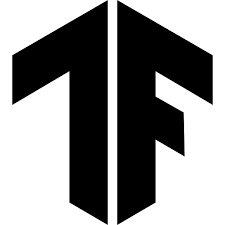</center>
</div>

---

<div>
<center style="color: #404040; font-family:  sans-serif; font-size: 100px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; background: #f9f9f9;">Taha Bouhsine</center>
    
<center style=" font-family: sans-serif; font-size: 31px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; background: #f9f9f9;"><span style="color:#4285F4;">G</span><span style="color:#EA4335">o</span><span style="color:#FBBC04;">o</span><span style="color:#4285F4;">g</span><span style="color:#34A853;">l</span><span style="color:#EA4335;">e</span> <span style="color:#404040;">Developer Student Clubs Lead</span><a href="https://gdsc.community.dev/university-of-ibn-zohr/"> @gdscuiz</a> </center>
    
<center style=" font-family: sans-serif; font-size: 31px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; background: #f9f9f9; color: #FF6F00;">TensorFlow User Group Agadir Lead Organizer<a href="https://www.meetup.com/TFUGAgadir/"> @tfugagadir</a> </center>

    
<center style=" font-size: 25px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; color:#404040;">Find me <i class="fab fa-github"></i> <a href="https://github.com/skywolfmo">@skywolfmo</a> - <i class="fab fa-twitter"></i> <a href="https://twitter.com/Tahabsn">@tahabsn</a></center>
    
<center> <i class="fa-solid fa-image-portrait"></i> <a href="www.tahabouhsine.me">www.tahabouhsine.me</a></center>
</div>

<center><a href="https://www.youtube.com/watch?v=aj1Xj-WN8uo" ><img width='700px' src="https://i.imgur.com/9kLpNMf.png"/></a></center>
<center style=" font-family: 'Helvetica Neue', sans-serif; font-size: 20; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; color:#111;">26 April 2022</a></center>

<div class="alert alert-block alert-info"> 📌 This notebook covers the basic medical images preparation for building a machine learning classifier with TensorFlow</div>

---

## Notebook Goals

- Learn the basic process of creating a machine learning solution for Computer Vision Problems
- Explore your images before feeding them to the model
- Use Data Augmentation to help your model generalize better
- Evaluate your model with different metrics and tools
- Investigate where your model false predicted things and understand why

***

<h2 style="color=#f9f9f9"> Table of Content</h2>

- [I - General Information](#s1)
- [II - Imports and hot SOS](#s2)
    - [2.1 - Imports](#s2-1)
    - [2.2 - Hot SOS](#s2-2)

- [III - Load and Clean](#s3)
- [IV - Expolratory Data Analysis (EDA)](#s4)
- [V - Modeling](#s5)
- [VI - Evaluation](#s6)
- [VII - Submission](#s7)
- [VIII - Conclusion](#s8)
- [IX - References](#s9)

---

<a id="s1"></a>
<center> <h2 style="color: #EA4335; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;">⚠️⚠️ DISCLAMER ⚠️⚠️</h2> </center>

<center><img width="600" src="https://i.imgur.com/CFUUAPj.png"/></center>

<center>I am by no means a doctor</center>

***

<a id="s1"></a>
<center> <h2 style="color: #404040; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;"> I - General Information ℹ️</h2> </center>

TODO: Add Slides

---

<a id="s2"></a>
<center> <h2 style="color: #404040; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;"> II - Imports and <b style="color:red;">🆘</b> functions (hot SOS) </h2> </center>


<a id="s2-1"></a>
## 2.1 - Imports

In [1]:
!pip install -U tensorflow-addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 4.0 MB/s eta 0:00:00
  Attempting uninstall: tensorflow-addons
    Found existing installation: tensorflow-addons 0.14.0
    Uninstalling tensorflow-addons-0.14.0:
      Successfully uninstalled tensorflow-addons-0.14.0


In [2]:
import datetime, os

from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, BatchNormalization, Dropout, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, TensorBoard, ModelCheckpoint
from tensorflow.keras.applications.nasnet import NASNetMobile
from tensorflow.keras import layers
import tensorflow_addons as tfa
from tensorflow.keras.callbacks import Callback

import tensorflow as tf

/opt/conda/lib/python3.7/site-packages/tensorflow_addons/utils/ensure_tf_install.py:67: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.8.0 and strictly below 2.11.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.6.4 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  UserWarning,


In [3]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import random
import matplotlib.cm as cm

from sklearn.metrics import classification_report, confusion_matrix

## 2.2 - Experiment parameters

In [4]:
SEED = 548
BATCH_SIZE = 64
EPOCHS = 250
LEARNING_RATE = 0.0005
IMAGE_SIZE = 224
im_shape = (IMAGE_SIZE, IMAGE_SIZE)
data_path = "/kaggle/input/brain-tumor-classification-mri"

<a id="s2-2"></a>

## 2.3 - Helper Functions 

In [5]:
def set_seed(seed):
    tf.random.set_seed(seed)
    random.seed(seed)
    np.random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)

set_seed(SEED)

In [6]:
def plot_history_acc_loss(history):
    epochs = range(len(history.history['loss']))
    fig, ax = plt.subplots(1,2,figsize=(14,7))
    train_acc = history.history['accuracy']
    train_loss = history.history['loss']
    val_acc = history.history['val_accuracy']
    val_loss = history.history['val_loss']

    fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
                 fontname='monospace',color=colors_dark[0],y=1,x=0.28,alpha=0.8)

    sns.despine()
    ax[0].plot(epochs, train_acc, color=colors_green[1],
               label = 'Training Accuracy')
    ax[0].plot(epochs, val_acc, color=colors_red[1],
               label = 'Validation Accuracy')
    ax[0].legend(frameon=False)
    ax[0].set_xlabel('Epochs')
    ax[0].set_ylabel('Accuracy')

    sns.despine()
    ax[1].plot(epochs, train_loss, color=colors_green[1],
               label ='Training Loss')
    ax[1].plot(epochs, val_loss, color=colors_red[1],
               label = 'Validation Loss')
    ax[1].legend(frameon=False)
    ax[1].set_xlabel('Epochs')
    ax[1].set_ylabel('Training & Validation Loss')

    fig.show()

In [7]:
def plot_history_precision_recall(history):
    epochs = range(len(history.history['loss']))
    fig, ax = plt.subplots(1,2,figsize=(14,7))
    train_acc = history.history['precision']
    train_loss = history.history['recall']
    val_acc = history.history['val_precision']
    val_loss = history.history['val_recall']

    fig.text(s='Epochs vs. Training and Validation Precision/Recall',size=18,fontweight='bold',
                 fontname='monospace',color=colors_dark[0],y=1,x=0.28,alpha=0.8)

    sns.despine()
    ax[0].plot(epochs, train_acc, color=colors_green[1],
               label = 'Training Precision')
    ax[0].plot(epochs, val_acc, color=colors_yellow[1],
               label = 'Validation Precision')
    ax[0].legend(frameon=False)
    ax[0].set_xlabel('Epochs')
    ax[0].set_ylabel('Training & Validation Precision')

    sns.despine()
    ax[1].plot(epochs, train_loss, color=colors_green[1],
               label ='Training Recall')
    ax[1].plot(epochs, val_loss, color=colors_yellow[1],
               label = 'Validation Recall')
    ax[1].legend(frameon=False)
    ax[1].set_xlabel('Epochs')
    ax[1].set_ylabel('Training & Validation Recall')

    fig.show()

In [8]:
def plot_history_accuracy_f1_score(history):
    epochs = range(len(history.history['loss']))
    
    fig, ax = plt.subplots(1,2,figsize=(14,7))
    train_acc = history.history['accuracy']
    train_loss = history.history['f1_score']
    val_acc = history.history['val_accuracy']
    val_loss = history.history['val_f1_score']

    fig.text(s='Epochs vs. Training and Validation Accuracy/F1 Score',size=18,fontweight='bold',
                 fontname='monospace',color=colors_dark[0],y=1,x=0.28,alpha=0.8)

    sns.despine()
    ax[0].plot(epochs, train_acc, color=colors_blue[1],
               label = 'Training Accuracy')
    ax[0].plot(epochs, val_acc, color=colors_red[1],
               label = 'Validation Accuracy')
    ax[0].legend(frameon=False)
    ax[0].set_xlabel('Epochs')
    ax[0].set_ylabel('Training & Validation Accuracy')

    sns.despine()
    ax[1].plot(epochs, train_loss, color=colors_blue[1],
               label ='Training F1 Score')
    ax[1].plot(epochs, val_loss, color=colors_red[1],
               label = 'Validation F1 Score')
    ax[1].legend(frameon=False)
    ax[1].set_xlabel('Epochs')
    ax[1].set_ylabel('Training & Validation F1 Score')

    fig.show()

In [9]:
def print_confusion_matrix(confusion_matrix, class_names, figsize = (12, 12), fontsize=14):
    group_counts = ["{0:0.0f}".format(value) for value in
                    confusion_matrix.flatten()]

    group_percentages = ["{0:.2%}".format(value) for value in
                         confusion_matrix.flatten() / np.sum(confusion_matrix)]

    labels = [f"{v2}\n{v3}" for v2, v3 in
              zip(group_counts, group_percentages)]
    labels = np.asarray(labels).reshape(len(class_names), len(class_names))

    
    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names, 
    )
    fig = plt.figure(figsize=figsize)
    try:
        heatmap = sns.heatmap(df_cm, annot=labels, fmt='', cmap='Blues')

    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    # Note that due to returning the created figure object, when this funciton is called in a notebook
    # the figure willl be printed twice. To prevent this, either append ; to your function call, or
    # modify the function by commenting out this return expression.
    return fig

In [10]:
def get_img_array(img):
    
    # `array` is a float32 Numpy array of shape (299, 299, 3)
    array = keras.preprocessing.image.img_to_array(img)
    # We add a dimension to transform our array into a "batch"
    # of size (1, 299, 299, 3)
    array = np.expand_dims(array, axis=0)
    return array


In [11]:
def display_gradcam(img, heatmap, cam_path="cam.jpg", alpha=0.4,preds=[0,0,0,0], plot=None):

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)
    
    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)

    # Save the superimposed image

    # Display Grad CAM
    plot.imshow(superimposed_img)
    plot.axis('off')


In [12]:
def gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.input], [model.get_layer(last_conv_layer_name).output,  model.output]
    )
    
    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
        
        
    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1))
    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [13]:
# Extracting False Negatives 
def evaluate_model(model, data, labels):
  false_predictions = []
  for img, label in zip(data, labels):
    image = image = tf.expand_dims(img, axis=0)
    predicted = model.predict(image)
    true_label= np.argmax(label)
    predicted_label = np.argmax(predicted)
    confidence = predicted[0][predicted_label]

    if true_label != predicted_label:
      false_predictions.append([img, true_label, predicted_label, confidence, predicted])
  return false_predictions

In [14]:
def sove_plots(false_predictions, model, last_conv_layer_name):
  for i, sample in enumerate(false_predictions):
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20, 10))
    plt.subplots_adjust(bottom=0)
    img, true_label, predicted_label, trust, prediction = sample[0], sample[1], sample[2], sample[3], sample[4][0]    

    im_class = classes[true_label]
    true_label_class = r"True Label: $\bf{" + str(classes[true_label]) + "}$"
    predicted_label_class = r"Predicted Label: $\it{"+ str(classes[predicted_label]) + "}$"

    confidence = "Confidence: " + str(trust)

    img_array = get_img_array(img)
    # Remove last layer's softmax
    model.layers[-1].activation = None
    # Print what the top predicted class is
    preds = model.predict(img_array)
    title = "{} \n {} \n {} \n".format(
        true_label_class, predicted_label_class, confidence)
    plt.axis('off')
    heatmap = gradcam_heatmap(img_array, model, last_layer_name)
    heatmap = np.reshape(heatmap, (7,7))
    display_gradcam(img, heatmap, preds=preds[0], plot=ax1)
    _ = ax2.imshow(img)
    _ = ax3.imshow(heatmap)
    ax1.set_title("GradCam")
    ax2.set_title(title)
    ax3.set_title('Attention Map')
    plt.show()
    plt.close()
    print('------------')


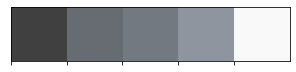

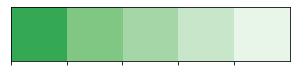

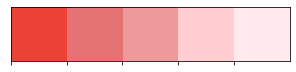

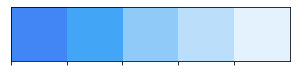

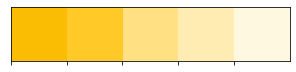

In [15]:
colors_dark = ["#404040", "#676c72", '#737980', '#8e959e', '#f9f9f9']
colors_red = ["#EA4335", "#E57373", '#EF9A9A', '#FFCDD2', '#FFEBEE']
colors_green = ['#34A853','#81C784','#A5D6A7','#C8E6C9','#E8F5E9']
colors_blue = ['#4285F4','#42A5F5','#90CAF9','#BBDEFB','#E3F2FD']
colors_yellow = ['#FBBC04','#FFCA28','#FFE082','#FFECB3','#FFF8E1']

sns.palplot(colors_dark)
sns.palplot(colors_green)
sns.palplot(colors_red)
sns.palplot(colors_blue)
sns.palplot(colors_yellow)

## 2.4 - W&B Initializing

TODO

---

<a id="s3"></a>
<center> <h2 style="color: #404040; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;"> 🧹 III - Load and Clean 🧹</h2> </center>



## 3.1 ImageDataGenerator

### EDA Data

In [16]:
eda_data_gen = ImageDataGenerator(
        rescale=1./255,
)

In [17]:
eda_generator = eda_data_gen.flow_from_directory(data_path+'/Training', target_size=im_shape, class_mode='categorical', subset="training")


classes = list(eda_generator.class_indices.keys())
print('Classes: '+str(classes))
num_classes  = len(classes)

Found 2870 images belonging to 4 classes.
Classes: ['glioma_tumor', 'meningioma_tumor', 'no_tumor', 'pituitary_tumor']


### Train/Test Data

In [18]:
data_gen = ImageDataGenerator(
        validation_split=0.2,
        rescale=1./255,
        zoom_range=0.2,
        rotation_range=90,
        horizontal_flip=True,
        vertical_flip=True,
        fill_mode='nearest'
)

test_gen = ImageDataGenerator(
        rescale=1./255,
)


In [19]:
print("Training Data:")
train_generator = data_gen.flow_from_directory(data_path + "/Training", target_size=im_shape, shuffle=True, seed=SEED,
                                                     class_mode='categorical', batch_size=BATCH_SIZE, subset="training")

print("Validation Data:")
validation_generator = data_gen.flow_from_directory(data_path + "/Training", target_size=im_shape, shuffle=False, seed=SEED,
                                                     class_mode='categorical', batch_size=BATCH_SIZE, subset="validation")

print("Test Data:")
test_generator = test_gen.flow_from_directory(data_path + "/Testing", target_size=im_shape, shuffle=False, seed=SEED,
                                                     class_mode='categorical', batch_size=BATCH_SIZE)

nb_train_samples = train_generator.samples
nb_validation_samples = validation_generator.samples

nb_test_samples = test_generator.samples

classes = list(train_generator.class_indices.keys())
print('Classes: '+str(classes))
num_classes  = len(classes)

Training Data:
Found 2297 images belonging to 4 classes.
Validation Data:
Found 573 images belonging to 4 classes.
Test Data:
Found 394 images belonging to 4 classes.
Classes: ['glioma_tumor', 'meningioma_tumor', 'no_tumor', 'pituitary_tumor']


In [20]:
steps_per_epoch = nb_train_samples // BATCH_SIZE
validation_steps = nb_validation_samples // BATCH_SIZE
test_steps = nb_test_samples // BATCH_SIZE

In [21]:
# Weight Balencing
from collections import Counter
counter = Counter(train_generator.classes)                          
max_val = float(max(counter.values()))       
class_weights = {class_id : nb_train_samples/(num_images * num_classes) for class_id, num_images in counter.items()}                     

In [22]:
class_weights

{0: 0.8687594553706506,
 1: 0.8727203647416414,
 2: 1.817246835443038,
 3: 0.8674471299093656}

---

<a id="s4"></a>
<center> <h2 style="color: #404040; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;">🔍️ IV - Exploratory Data Analysis 🔎</h2> </center>


## 4.1 - Random Visualization

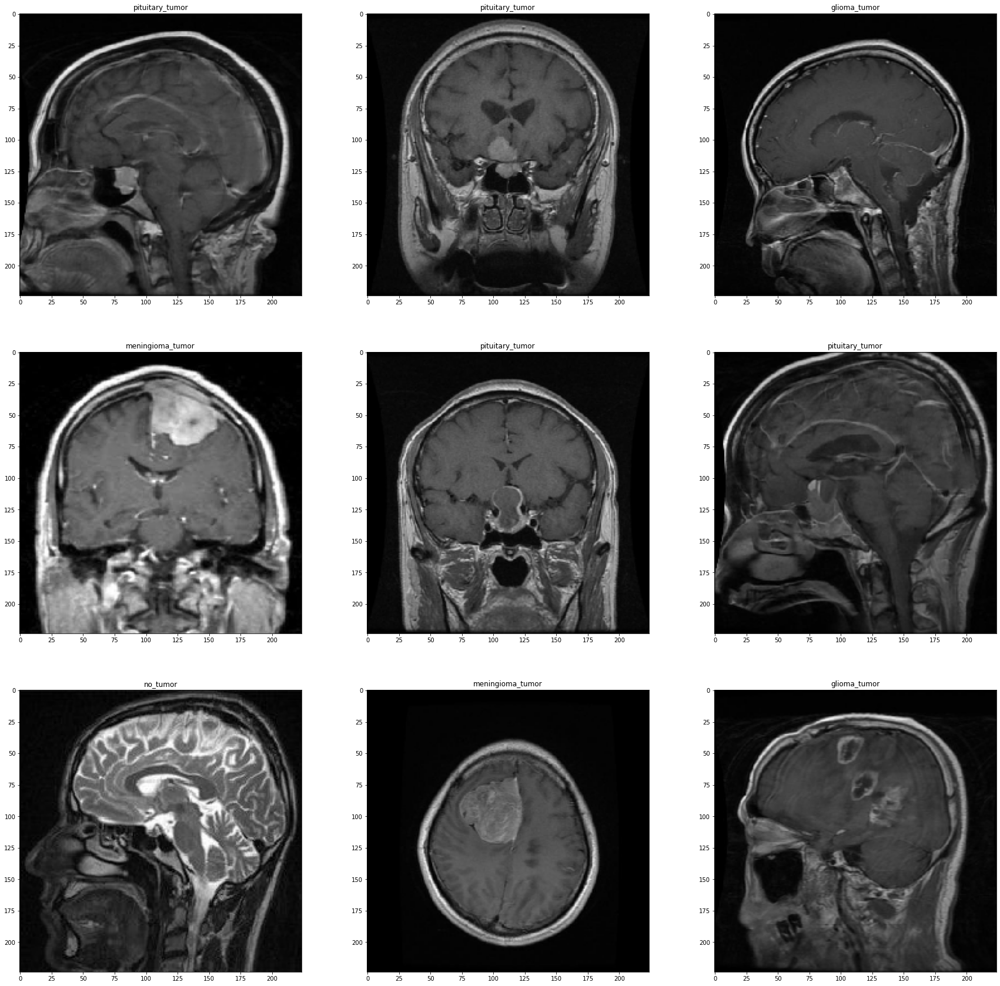

In [23]:
plt.figure(figsize=(30,30))
images = eda_generator.next()*255
for i, (image, l) in enumerate(zip(images[0][:9],images[1][:9])):
    ax = plt.subplot(330 + 1 + i)
    ax.set_title( classes[np.argmax(l)] )
    plt.imshow(image)
plt.show()

## 4.2 Classes

### Pituitary Tumor 
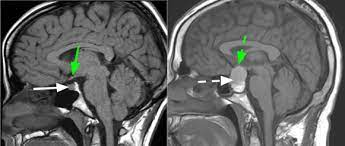


Text(0.5, 1.0, 'Pituitary Tumor')

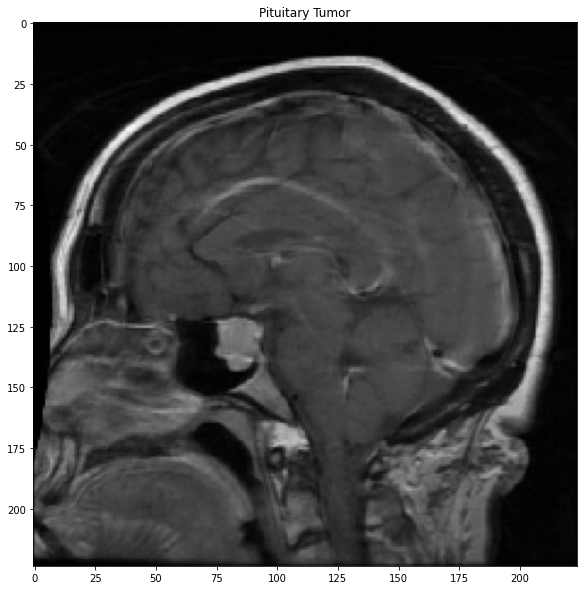

In [24]:
pituitary_tumor_sample = images[0][0]
plt.figure(figsize=(10,10))
plt.imshow(pituitary_tumor_sample)
plt.title("Pituitary Tumor")
# 125, 100 

Text(0.5, 1.0, 'Pituitary Tumor')

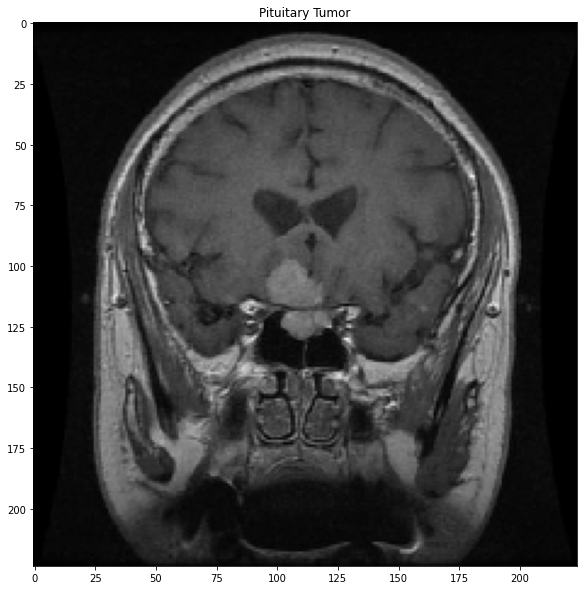

In [25]:
pituitary_tumor_sample = images[0][1]
plt.figure(figsize=(10,10))
plt.imshow(pituitary_tumor_sample)
plt.title("Pituitary Tumor")
# 100, 100

### Glioma Tumor

Text(0.5, 1.0, 'Glioma Tumor')

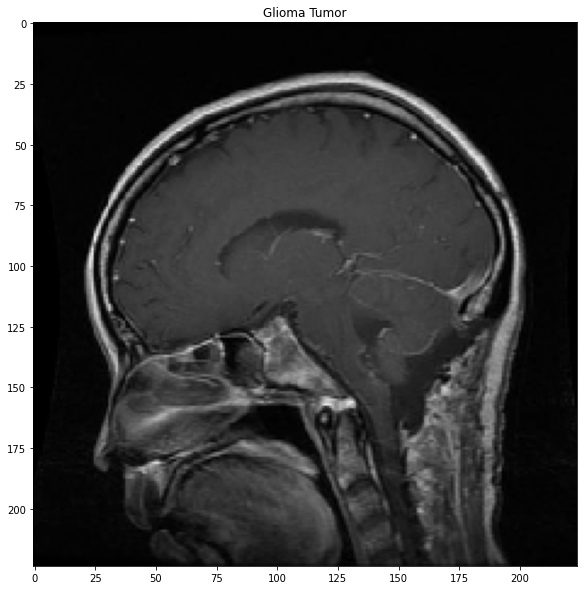

In [26]:
glioma_tumor_sample = images[0][2]
plt.figure(figsize=(10,10))
plt.imshow(glioma_tumor_sample)
plt.title("Glioma Tumor")

### Meningioma Tumor


Text(0.5, 1.0, 'Meningioma Tumor')

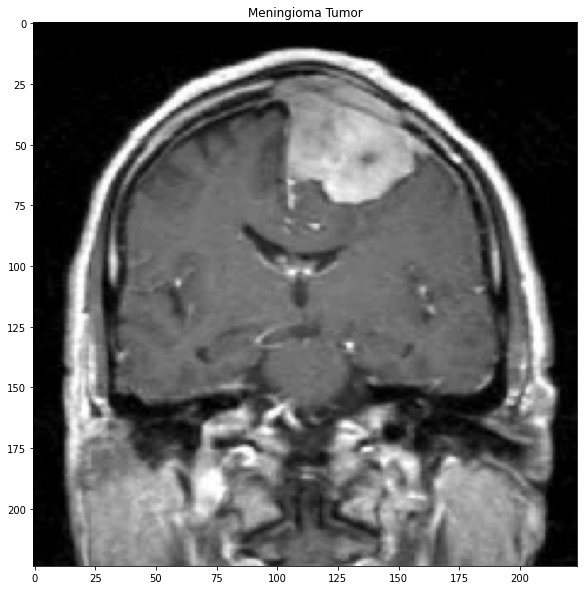

In [27]:
meningioma_tumor_sample = images[0][3]
plt.figure(figsize=(10,10))
plt.imshow(meningioma_tumor_sample)
plt.title("Meningioma Tumor")
# 75, 75

### No Tumor

Text(0.5, 1.0, 'No Tumor')

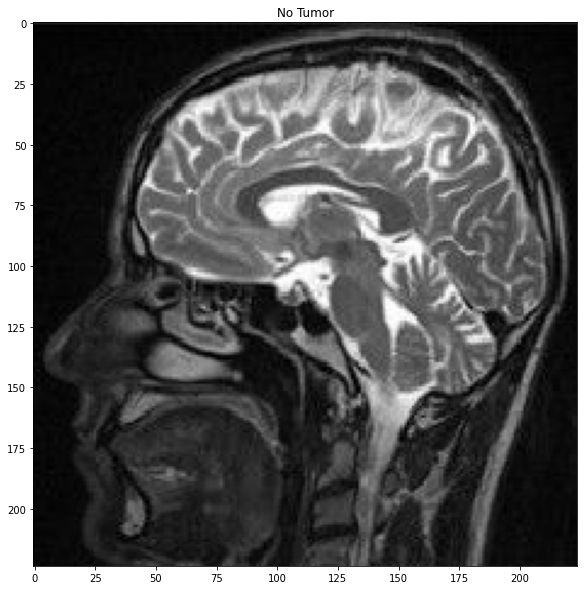

In [28]:
no_tumor_sample = images[0][6]
plt.figure(figsize=(10,10))
plt.imshow(no_tumor_sample)
plt.title("No Tumor")

---

<a id="s5"></a>

<center> <h2 style="color: #404040; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;">🤖 V - Modeling 🤖</h2> </center>


## 5.1 Transfer Learning Model

In [29]:
transfer_model = NASNetMobile(weights='imagenet', include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
for l in transfer_model.layers:
# Freezing the model
  l.trainable = False

2022-11-25 23:41:57.971368: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-25 23:41:58.068886: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-25 23:41:58.069715: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-25 23:41:58.071425: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

20004864/19993432 [==============================] - 0s 0us/step


## Model Definition

In [30]:
model = transfer_model.output
model = tf.keras.layers.Flatten()(model)
model = tf.keras.layers.Dropout(rate=0.2)(model)
model = tf.keras.layers.Dense(16, activation='relu')(model)
model = tf.keras.layers.Dense(32, activation='relu')(model)
model = tf.keras.layers.Dense(64, activation='relu')(model)
model = tf.keras.layers.Dense(32, activation='relu')(model)
model = tf.keras.layers.Dense(16, activation='relu')(model)
model = tf.keras.layers.Dense(num_classes, activation='softmax', kernel_regularizer='l1_l2')(model)
model = tf.keras.models.Model(inputs=transfer_model.input, outputs = model)


In [31]:
opt = tf.keras.optimizers.Adam(learning_rate= LEARNING_RATE,     amsgrad=True)
metrics = ['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=num_classes, threshold=0.5)]

In [32]:
model.compile(loss='categorical_crossentropy',optimizer = opt, metrics= metrics)

In [33]:
checkpoint = ModelCheckpoint("check_model.h5", monitor="val_accuracy", save_best_only=True, mode="auto", verbose=1)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10)


In [34]:
callbacks = [checkpoint, early_stopping]

In [35]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 111, 111, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 111, 111, 32) 128         stem_conv1[0][0]                 
__________________________________________________________________________________________________
activation (Activation)         (None, 111, 111, 32) 0           stem_bn1[0][0]                   
______________________________________________________________________________________________

## 5.3 Training

In [36]:
history = model.fit(
      train_generator,
      callbacks=callbacks,
      steps_per_epoch = steps_per_epoch,
      epochs = EPOCHS,
      validation_data = validation_generator,
      verbose = 1,
      validation_steps = validation_steps,
      class_weight=class_weights
    )

2022-11-25 23:42:08.194572: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/250


2022-11-25 23:42:22.396101: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


35/35 [==============================] - 71s 2s/step - loss: 1.5842 - accuracy: 0.2987 - precision: 0.1905 - recall: 0.0036 - f1_score: 0.0114 - val_loss: 1.5559 - val_accuracy: 0.2520 - val_precision: 0.8000 - val_recall: 0.0312 - val_f1_score: 0.0808

Epoch 00001: val_accuracy improved from -inf to 0.25195, saving model to check_model.h5


/opt/conda/lib/python3.7/site-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 2/250
35/35 [==============================] - 43s 1s/step - loss: 1.4144 - accuracy: 0.3677 - precision: 0.6269 - recall: 0.0940 - f1_score: 0.1636 - val_loss: 1.5465 - val_accuracy: 0.2734 - val_precision: 0.5447 - val_recall: 0.1309 - val_f1_score: 0.1658

Epoch 00002: val_accuracy improved from 0.25195 to 0.27344, saving model to check_model.h5
Epoch 3/250
35/35 [==============================] - 43s 1s/step - loss: 1.3142 - accuracy: 0.3981 - precision: 0.6721 - recall: 0.1469 - f1_score: 0.2320 - val_loss: 1.4341 - val_accuracy: 0.3301 - val_precision: 0.5610 - val_recall: 0.3145 - val_f1_score: 0.3486

Epoch 00003: val_accuracy improved from 0.27344 to 0.33008, saving model to check_model.h5
Epoch 4/250
35/35 [==============================] - 42s 1s/step - loss: 1.0869 - accuracy: 0.5432 - precision: 0.7137 - recall: 0.4254 - f1_score: 0.4807 - val_loss: 1.3115 - val_accuracy: 0.5410 - val_precision: 0.6186 - val_recall: 0.4277 - val_f1_score: 0.4789

Epoch 00004: val_acc

---

<a id="s6"></a>

<center> <h2 style="color: #404040; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;">📈 VI - Evaluation  📉</h2></center>

### Metrics

<center><img width="400" src="https://upload.wikimedia.org/wikipedia/commons/thumb/2/26/Precisionrecall.svg/800px-Precisionrecall.svg.png" /></center>

$$Accuracy = \frac{TP + TN}{TP + TN + FP + FN}$$


$$Precision = \frac{TP}{TP + FP}$$


$$Recall = \frac{TP}{TP + FN}$$

$$F1\ SCORE = 2 * \frac{Precision * Recall}{Precision + Recall}$$

## 6.1 Plotting loss/accuracy

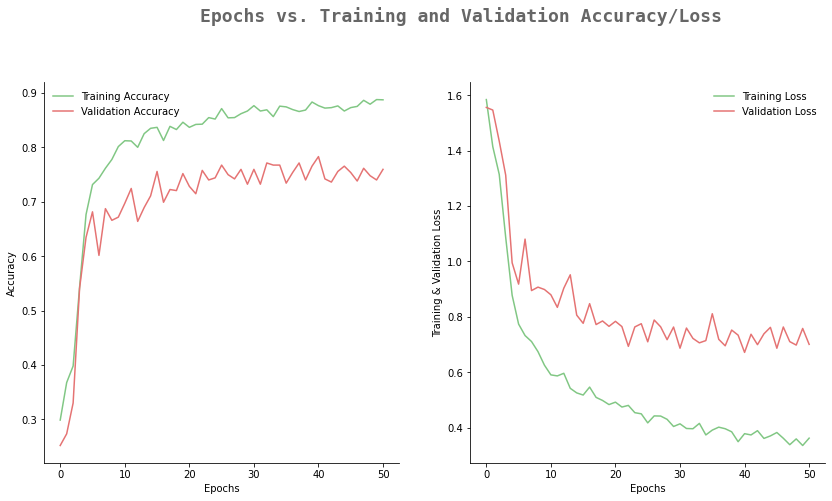

In [37]:
plot_history_acc_loss(history)

## 6.2 Plotting Precision/Recall

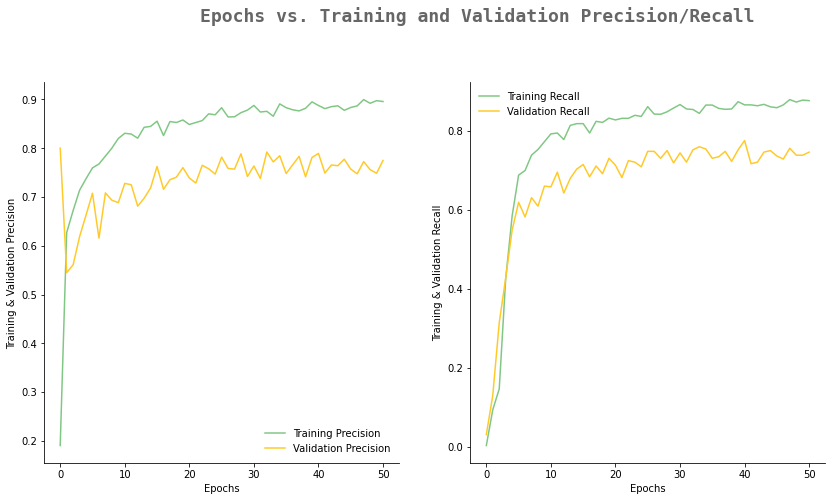

In [38]:
plot_history_precision_recall(history)

## 6.4 Test Evaluation

### Loading best validation accuracy model

In [39]:
model.load_weights('check_model.h5')

In [40]:
model.evaluate(test_generator)

7/7 [==============================] - 3s 491ms/step - loss: 1.1950 - accuracy: 0.6294 - precision: 0.6620 - recall: 0.6066 - f1_score: 0.6166


[1.1949793100357056,
 0.6294416189193726,
 0.6620498895645142,
 0.606598973274231,
 array([0.3971631, 0.6245353, 0.7830189, 0.6616542], dtype=float32)]

### Confusion Matrix

In [41]:
test_data, test_labels = zip(*(test_generator[i] for i in range(test_steps)))
test_data, test_labels = np.vstack(test_data), np.vstack(test_labels)

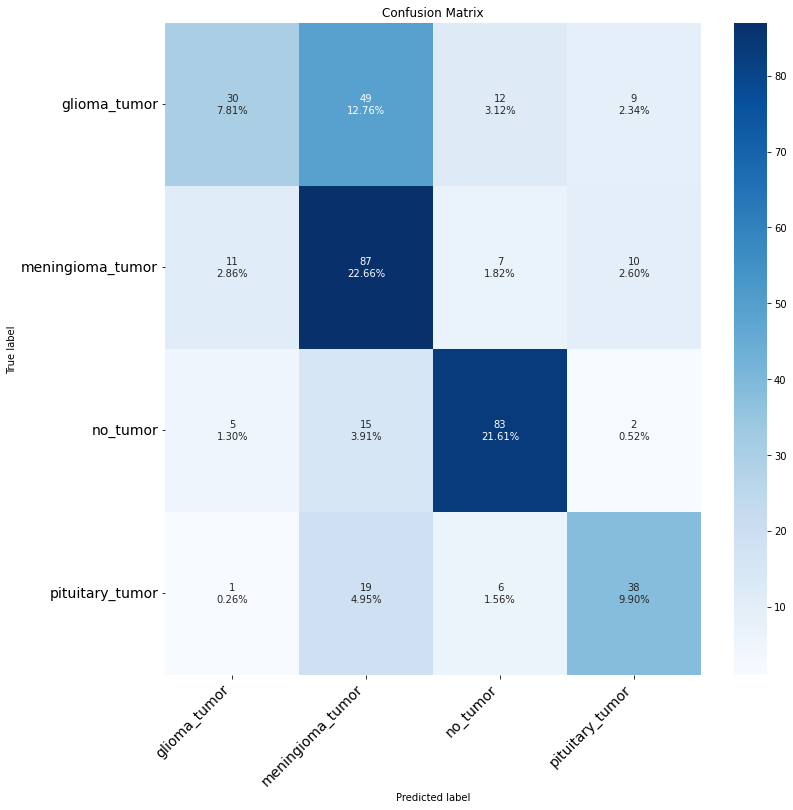

In [42]:
test_predictions = model.predict(test_data)
ground_truth_class_ids = test_labels.argmax(axis=1)

# take the argmax for each set of prediction scores
# to return the class id of the highest confidence prediction
top_pred_ids = test_predictions.argmax(axis=1)
conf_mat = confusion_matrix(ground_truth_class_ids, top_pred_ids)
figure = print_confusion_matrix(conf_mat, classes)
plt.title('Confusion Matrix')
plt.show()



### Extracting False Predictions

In [43]:
false_predictions = evaluate_model(model, test_data, test_labels)

In [44]:
print(len(false_predictions))

146


In [45]:
last_layer_name = 'activation_187'

### GradCam and Attention Map

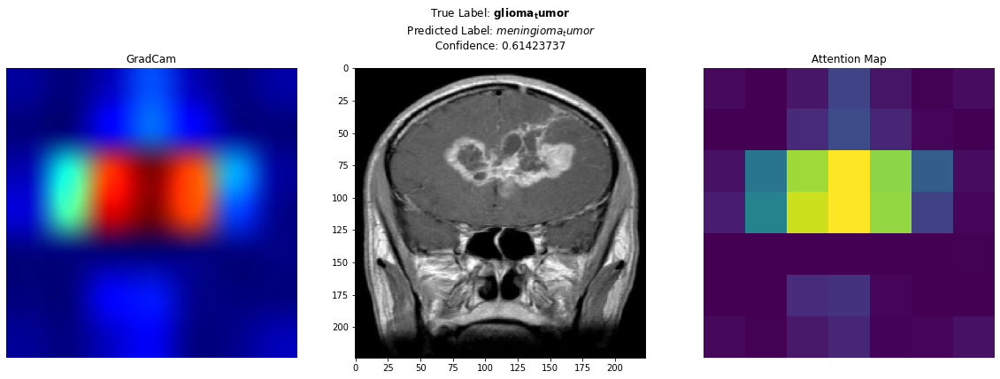

------------


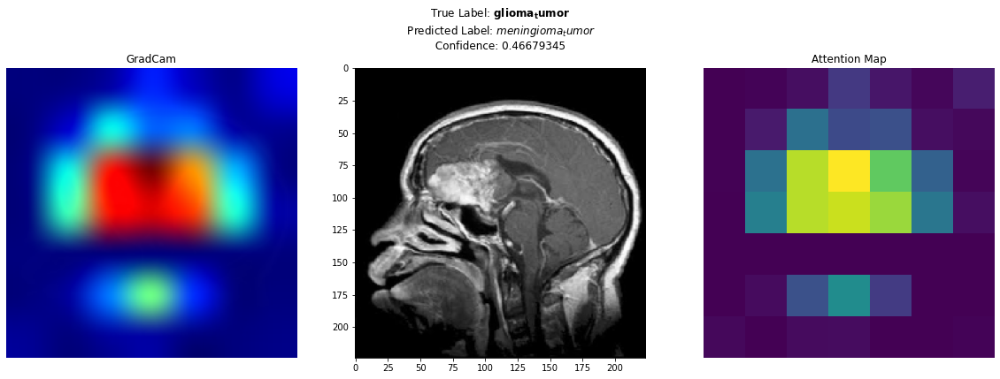

------------


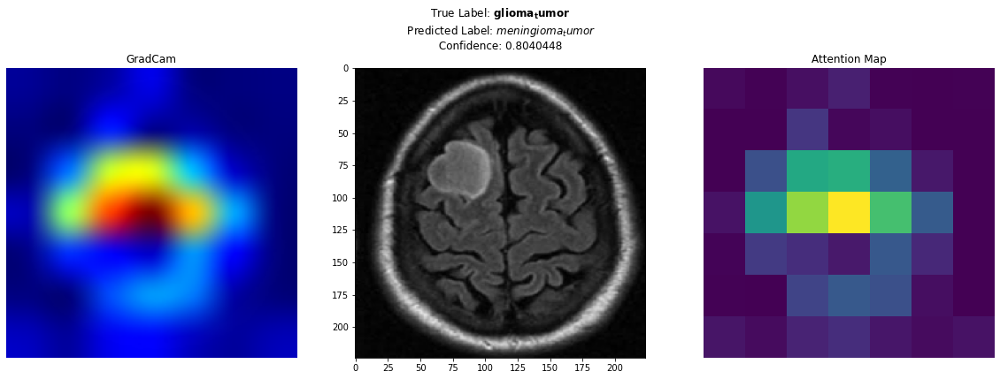

------------


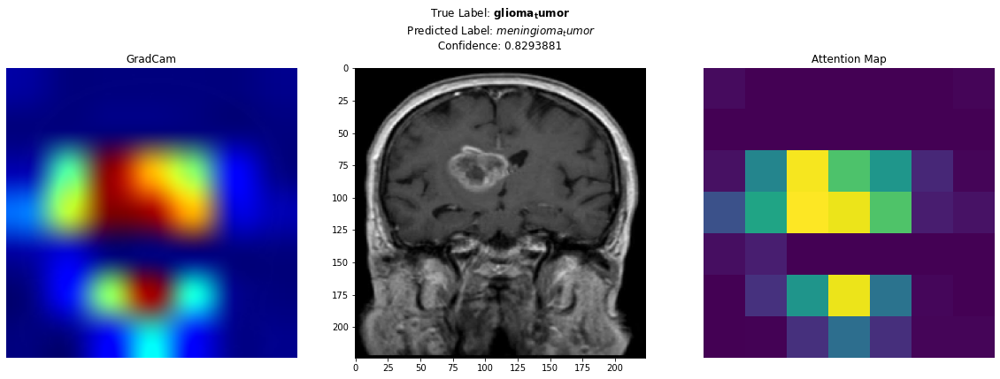

------------


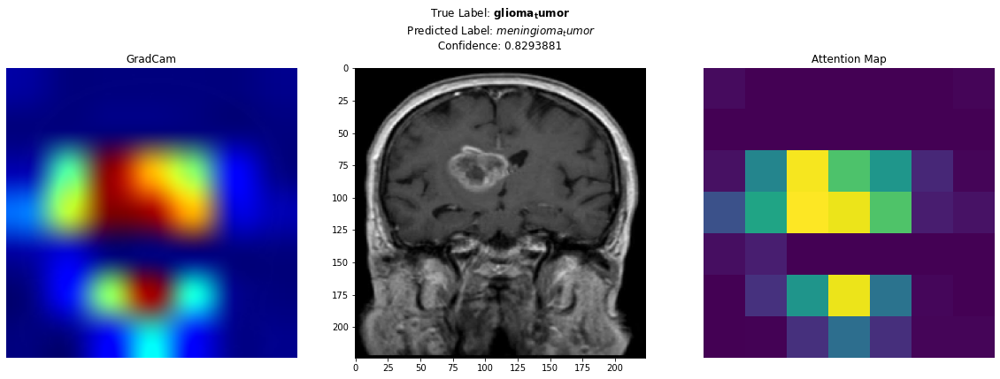

------------


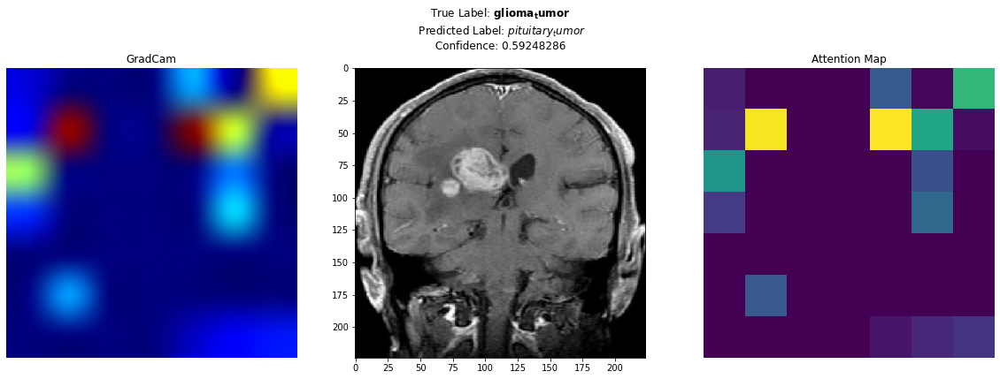

------------


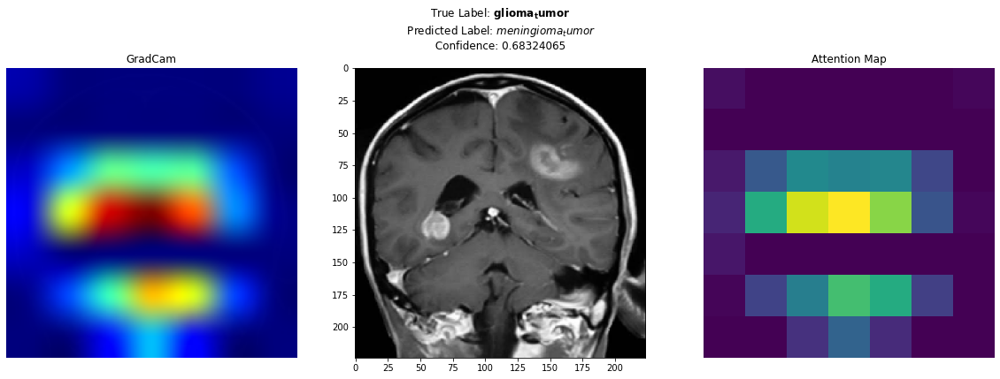

------------


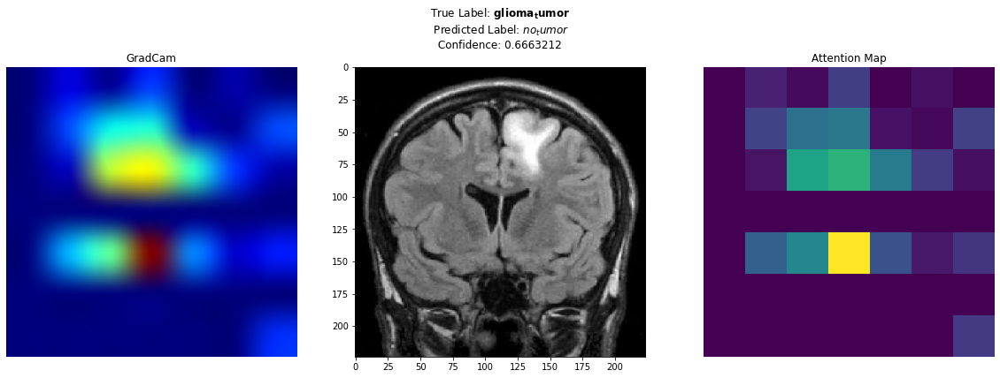

------------


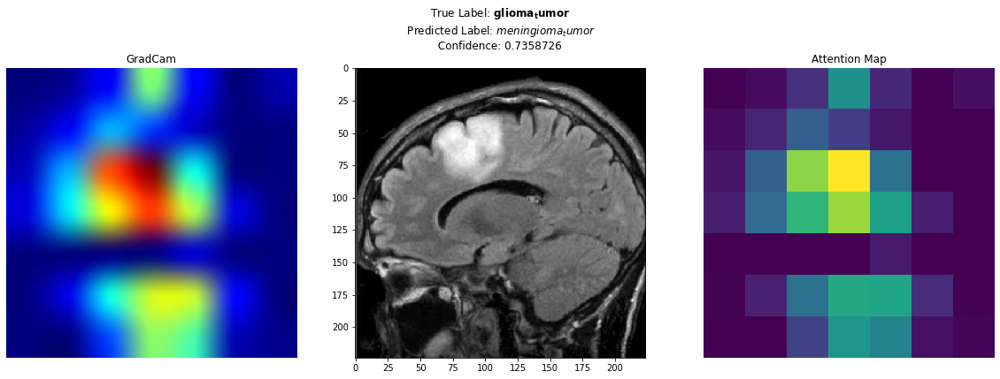

------------


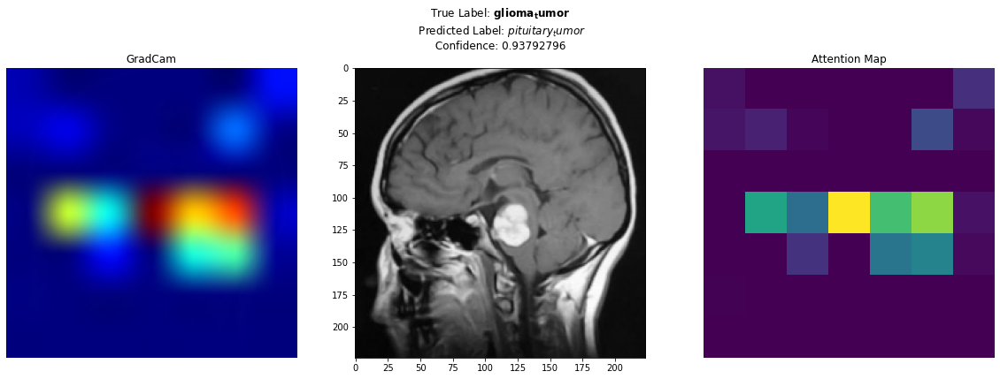

------------


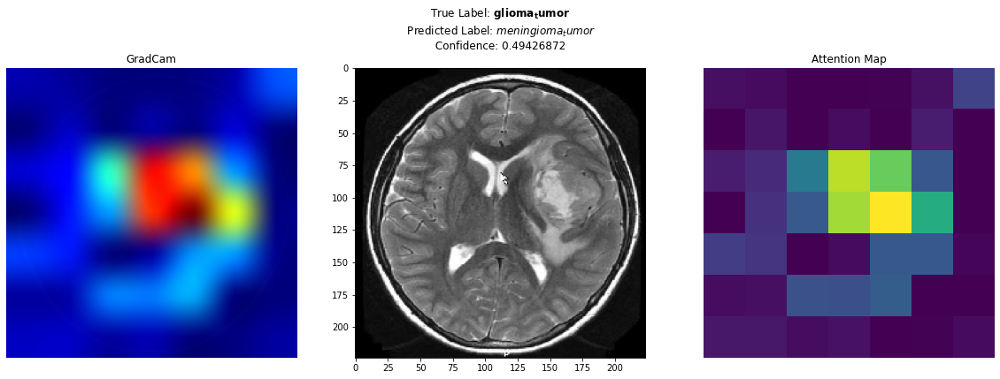

------------


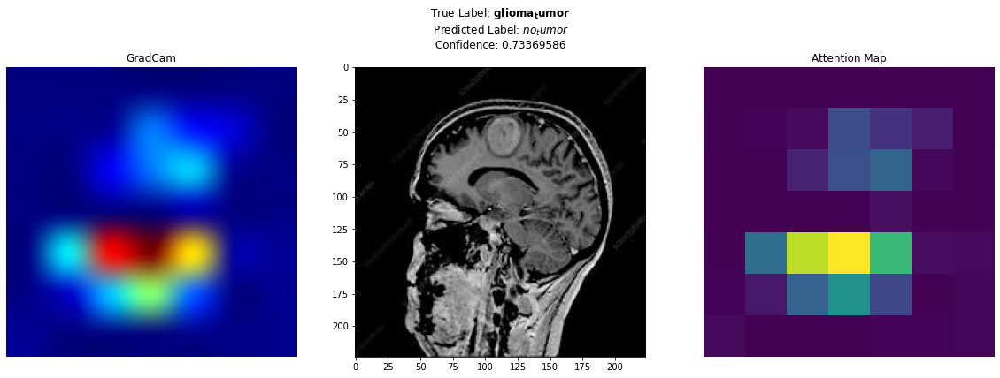

------------


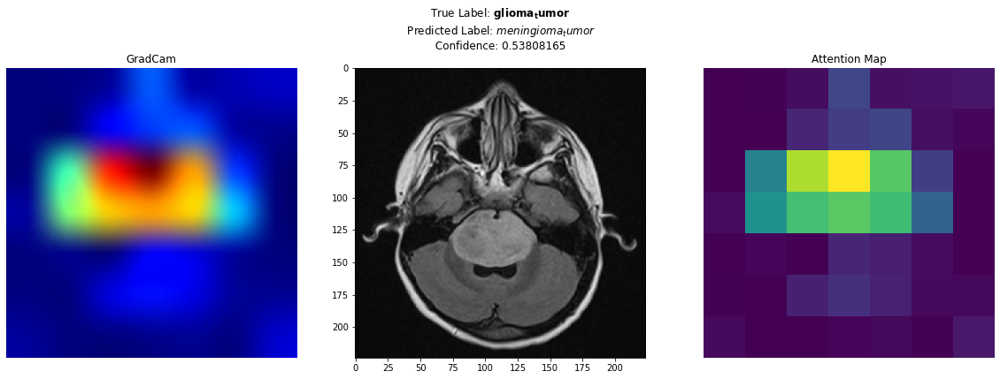

------------


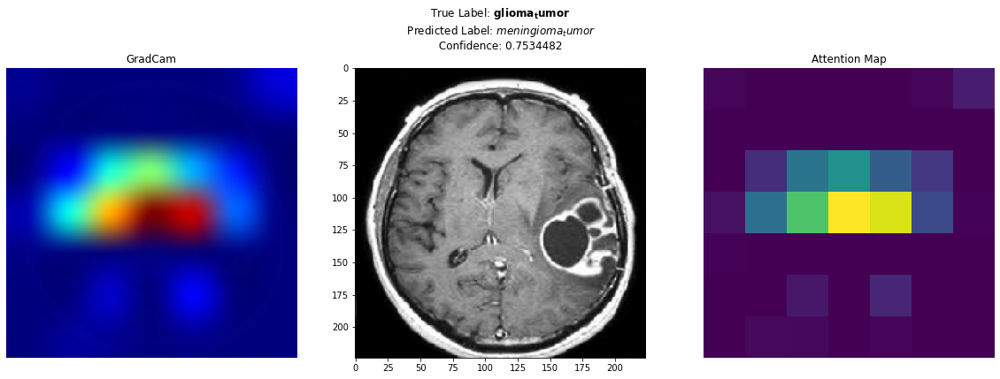

------------


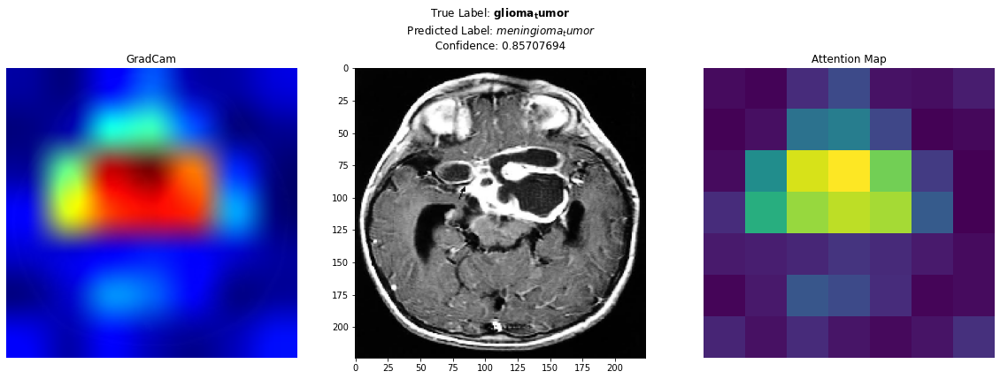

------------


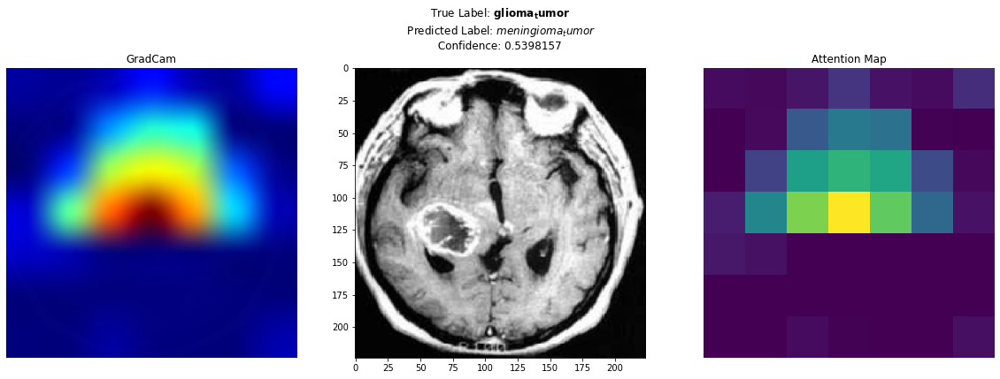

------------


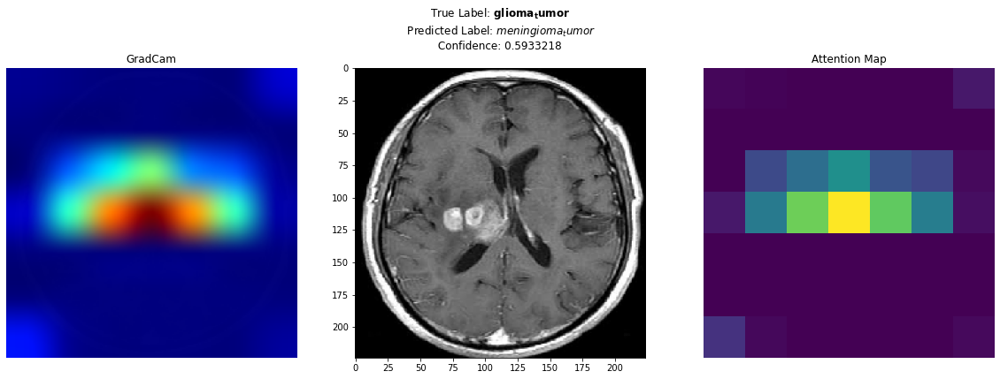

------------


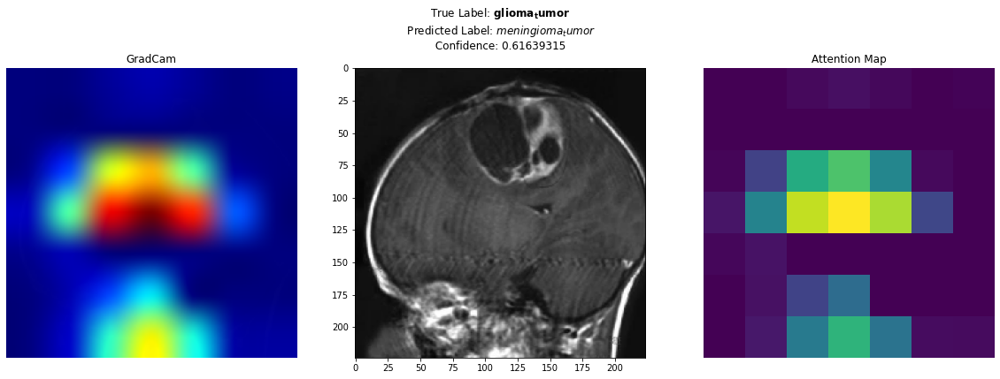

------------


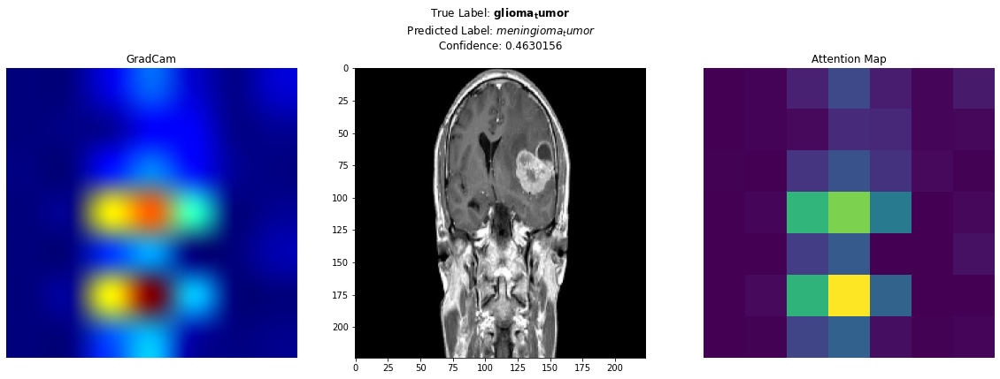

------------


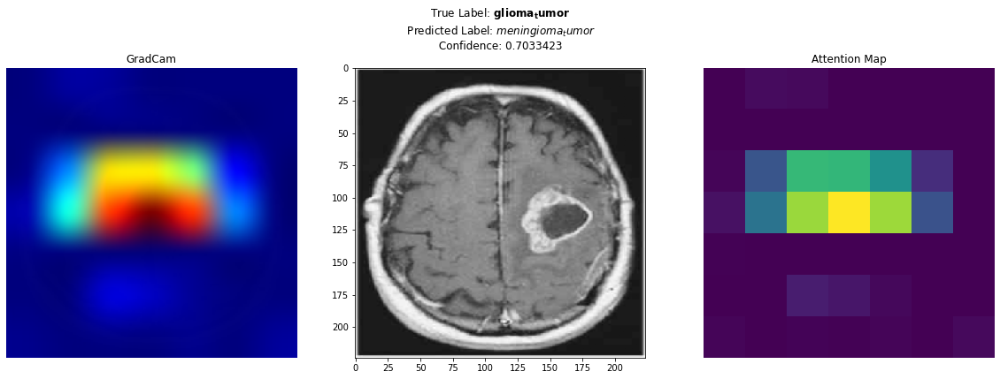

------------


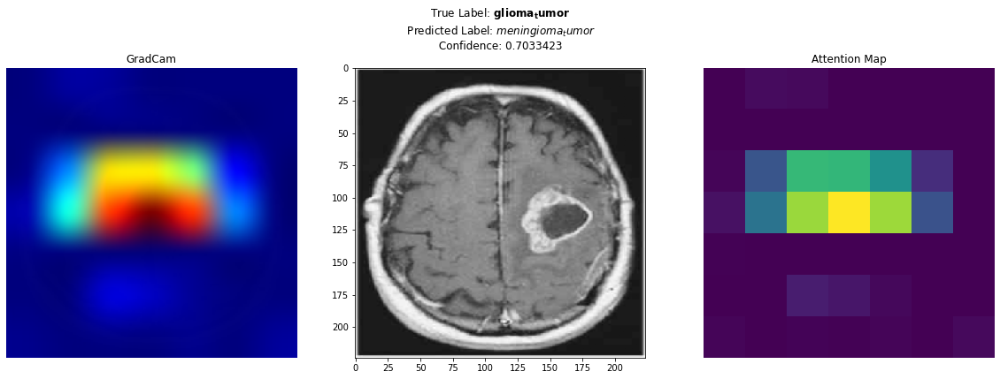

------------


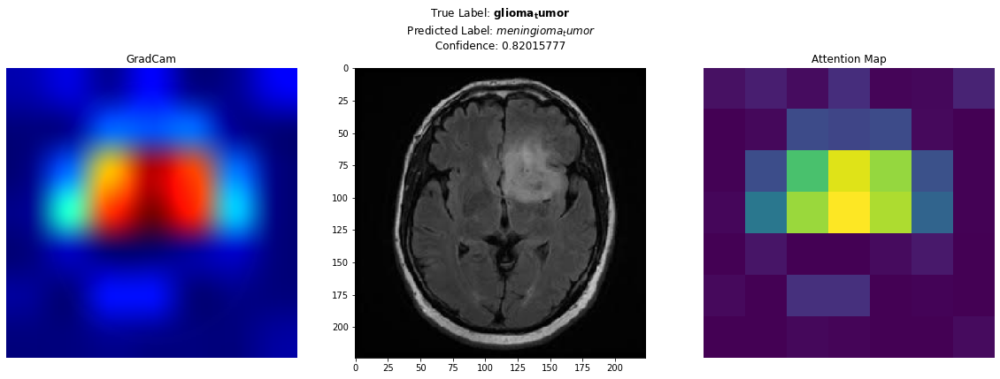

------------


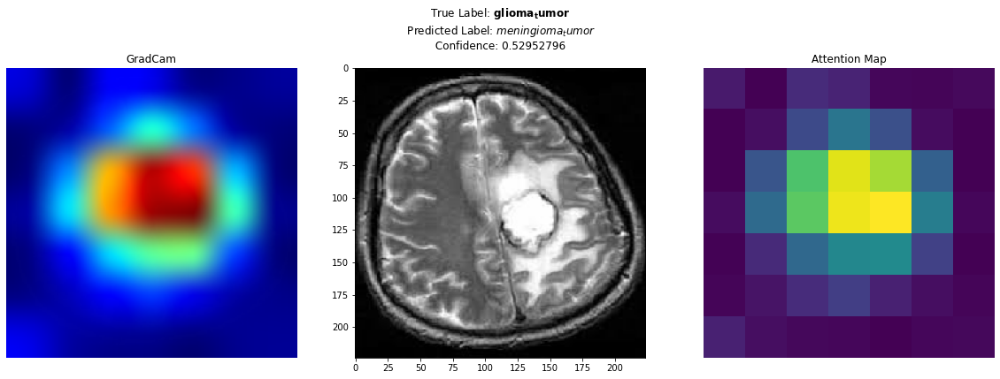

------------


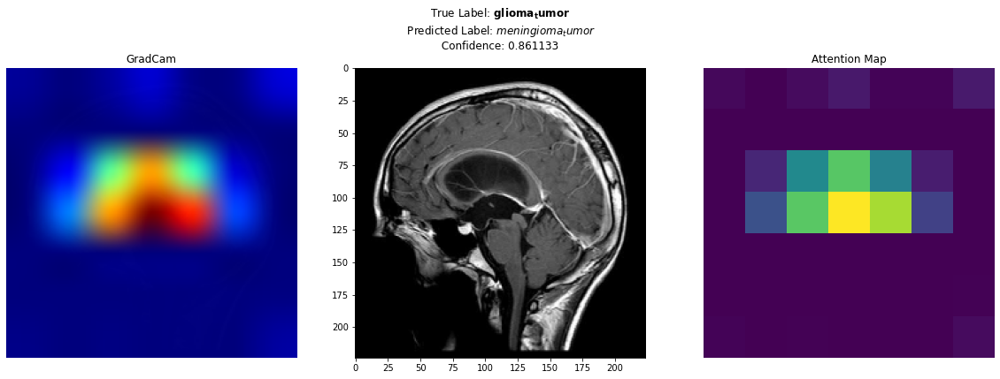

------------


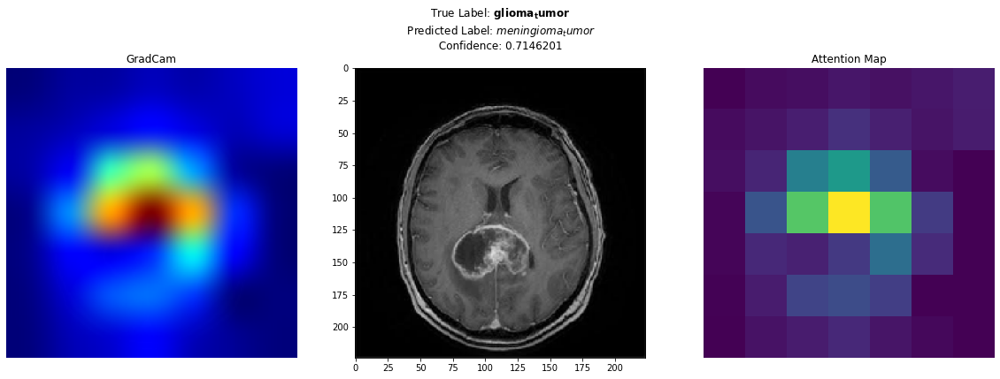

------------


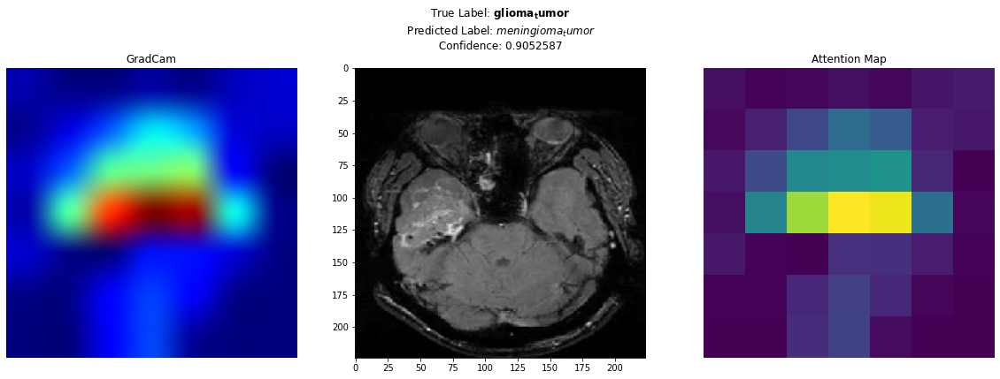

------------


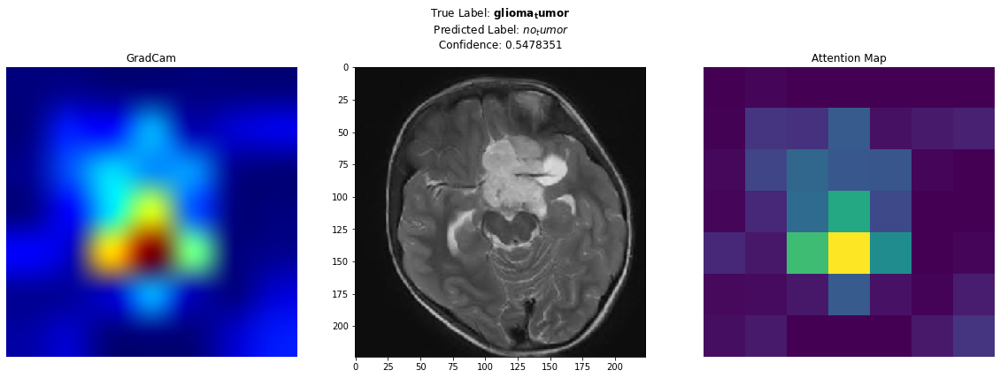

------------


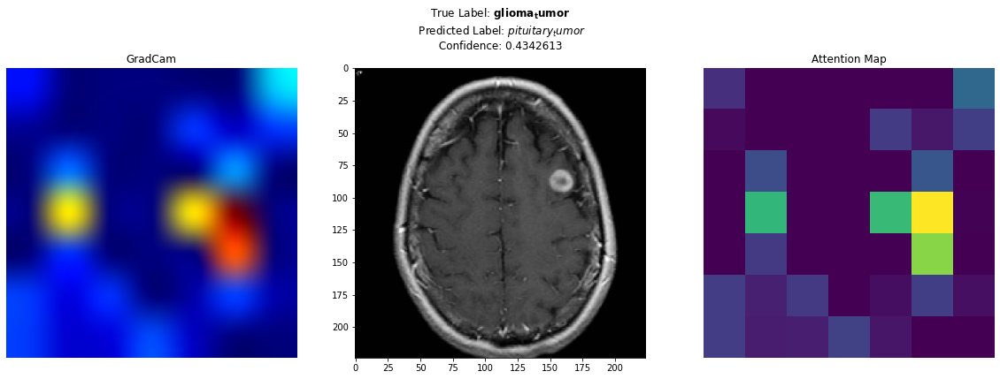

------------


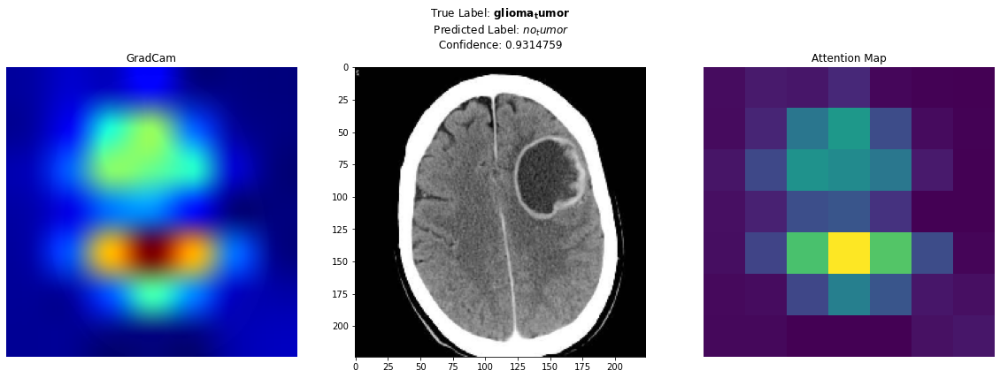

------------


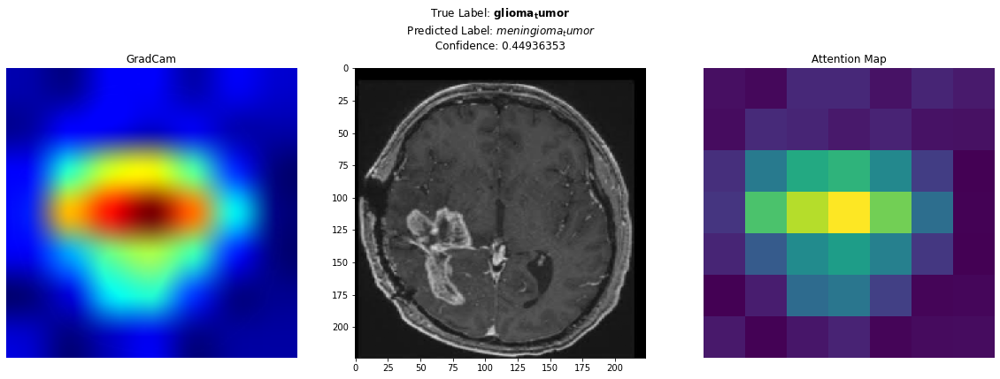

------------


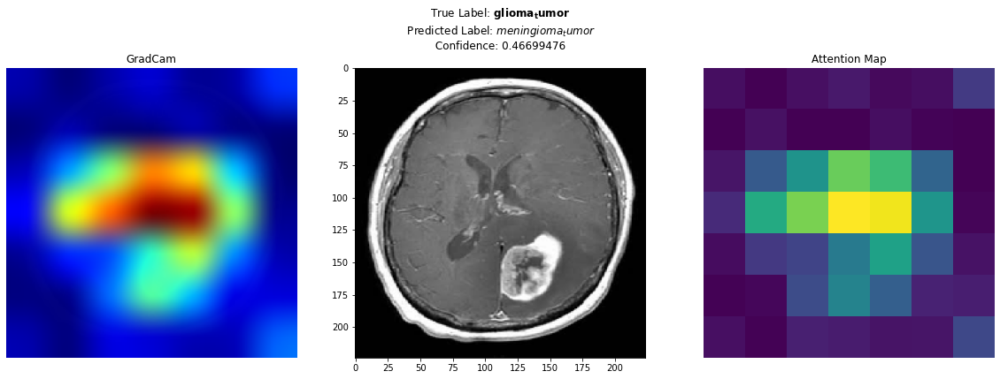

------------


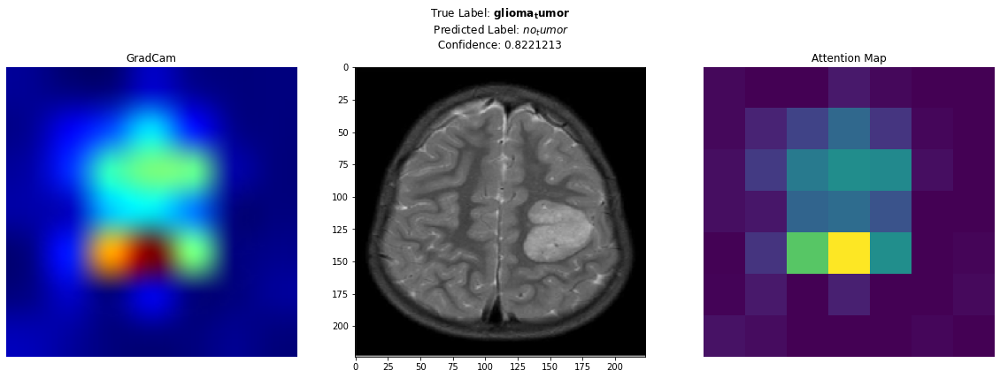

------------


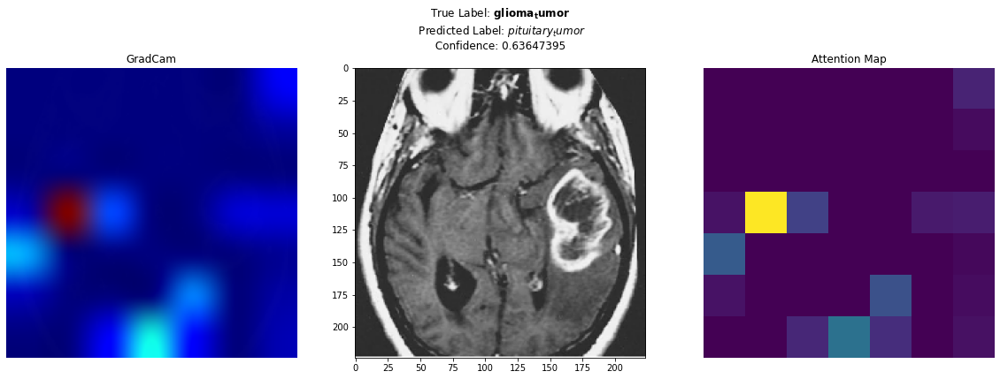

------------


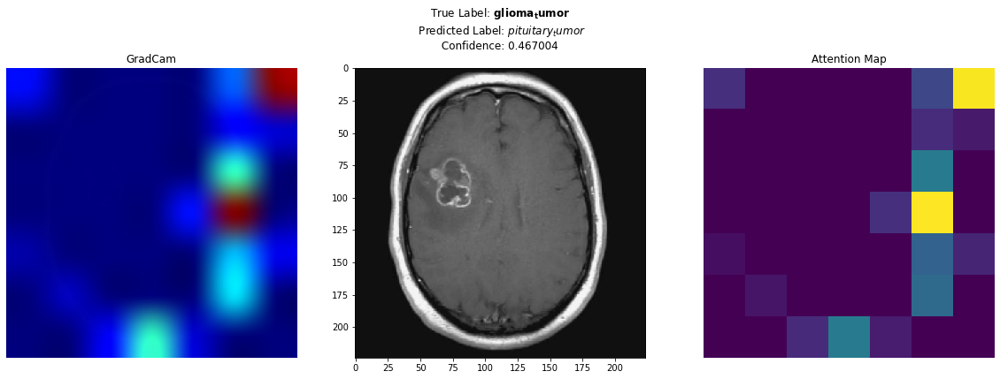

------------


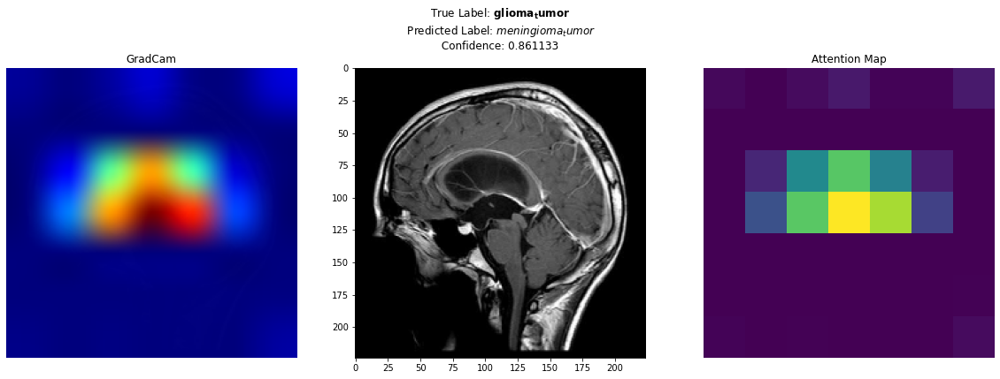

------------


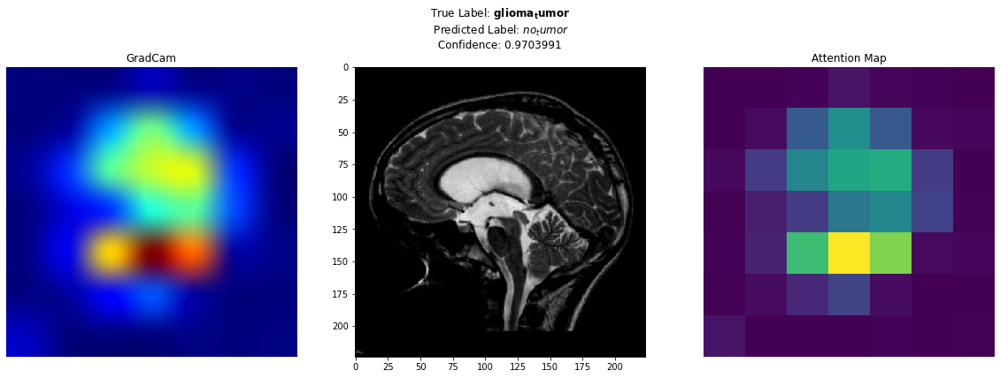

------------


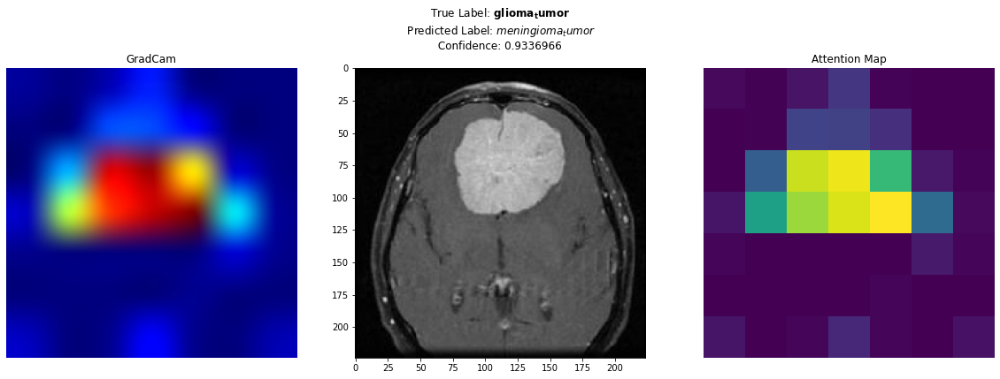

------------


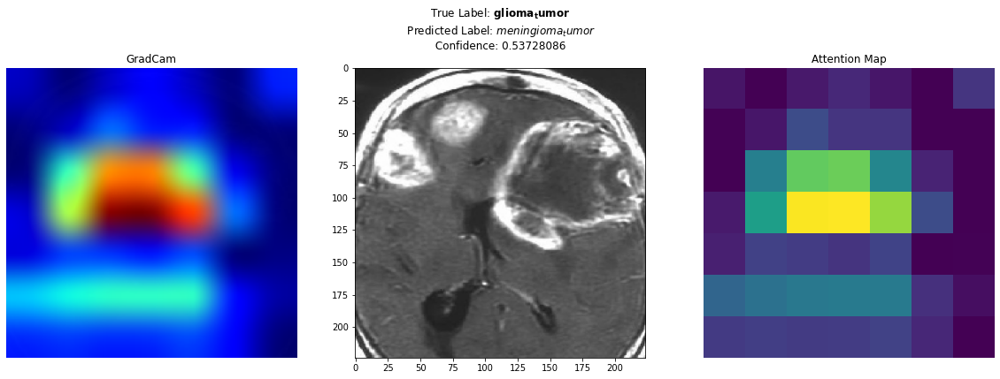

------------


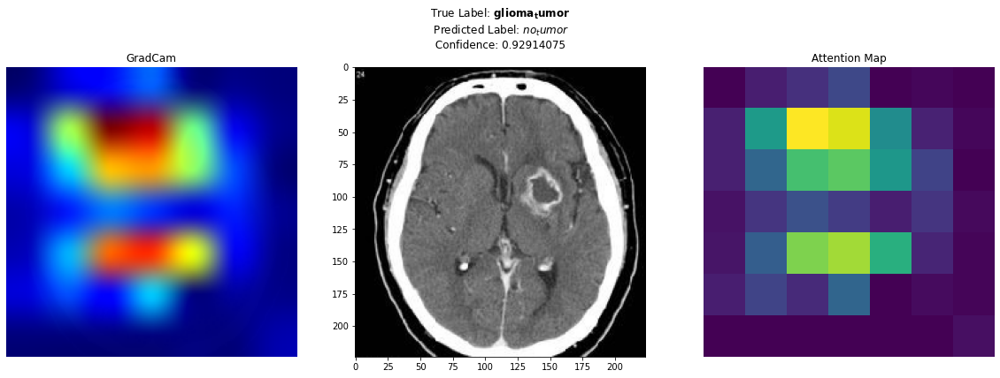

------------


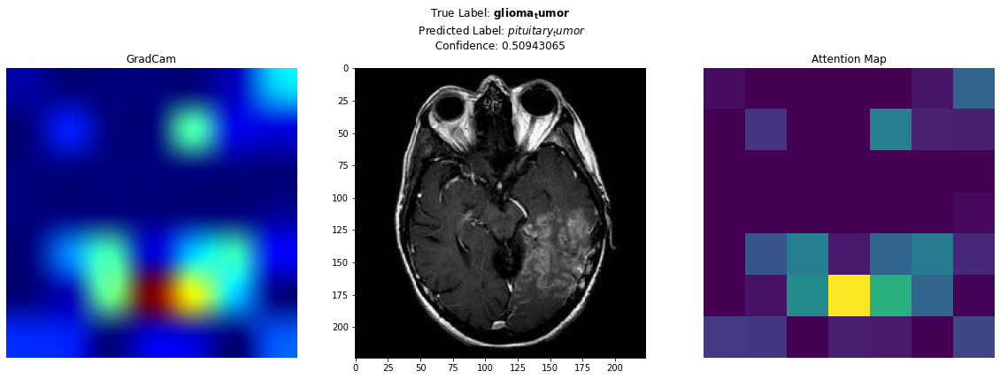

------------


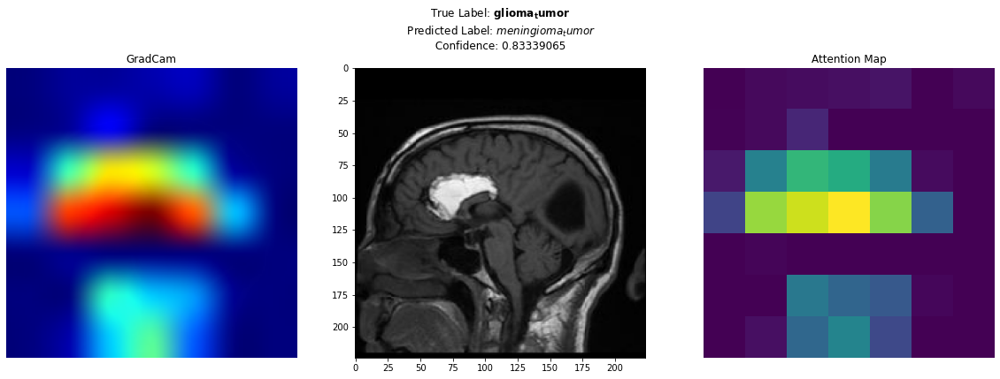

------------


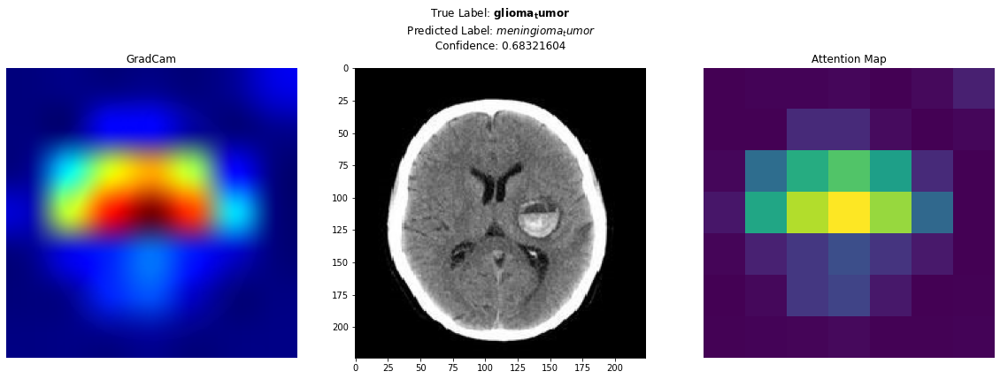

------------


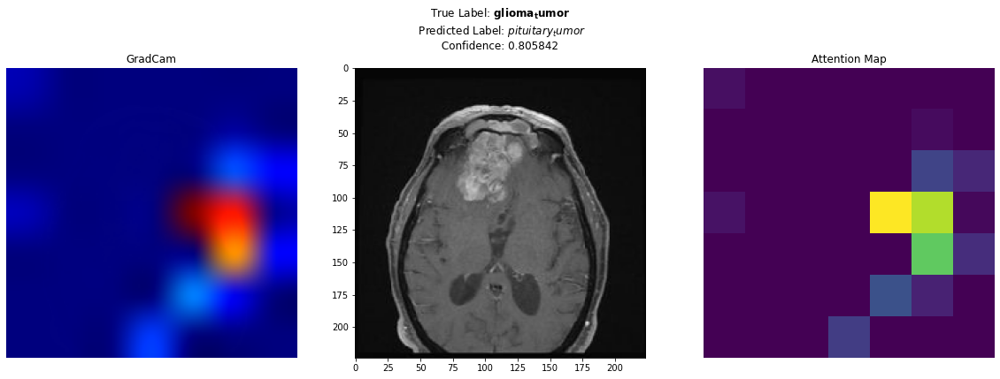

------------


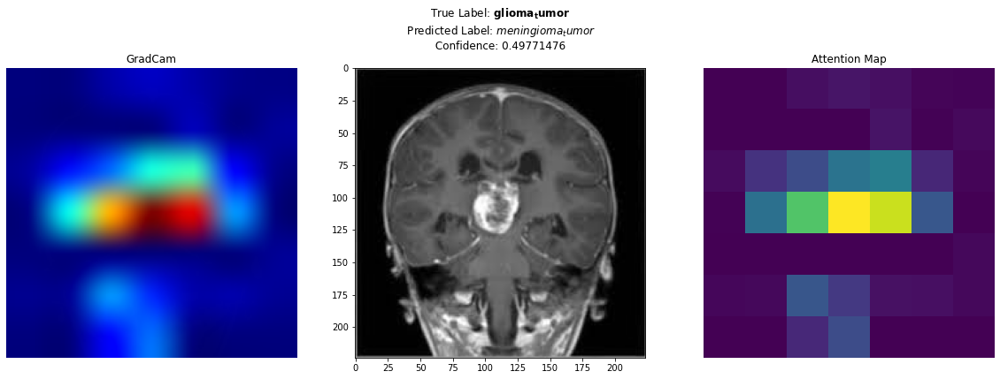

------------


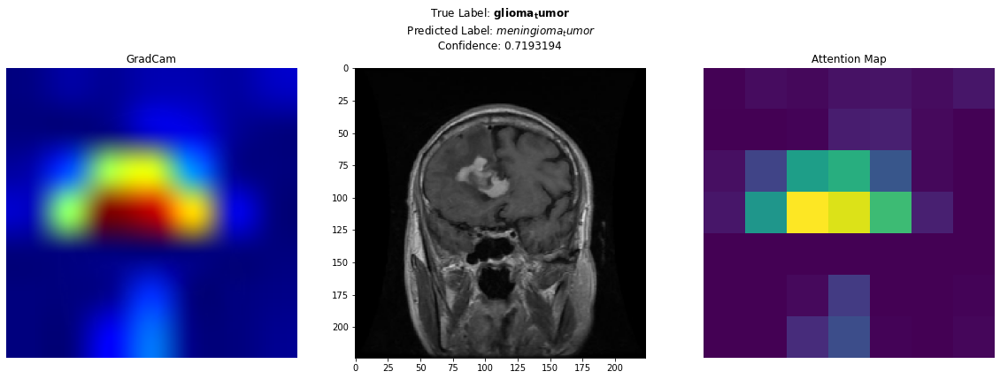

------------


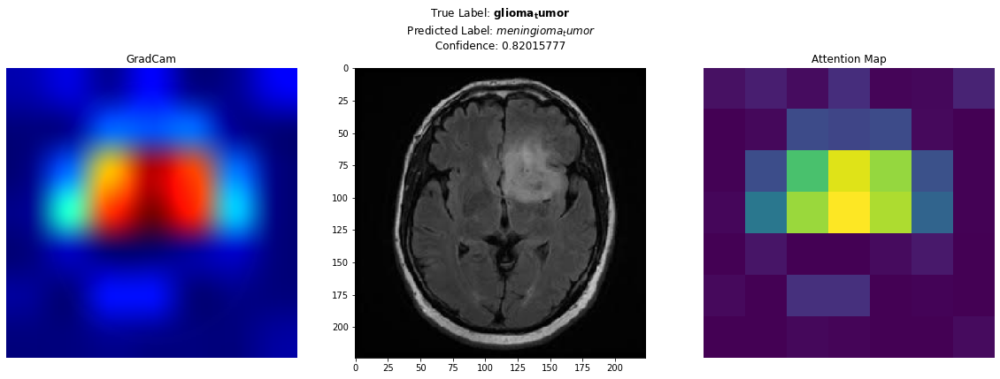

------------


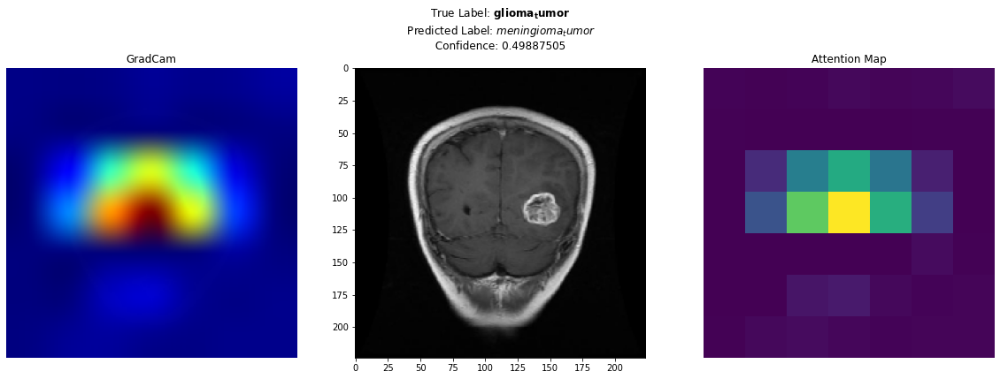

------------


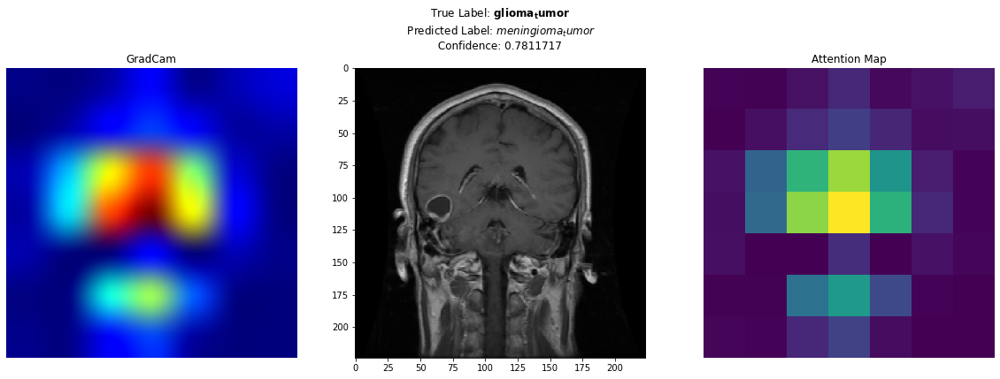

------------


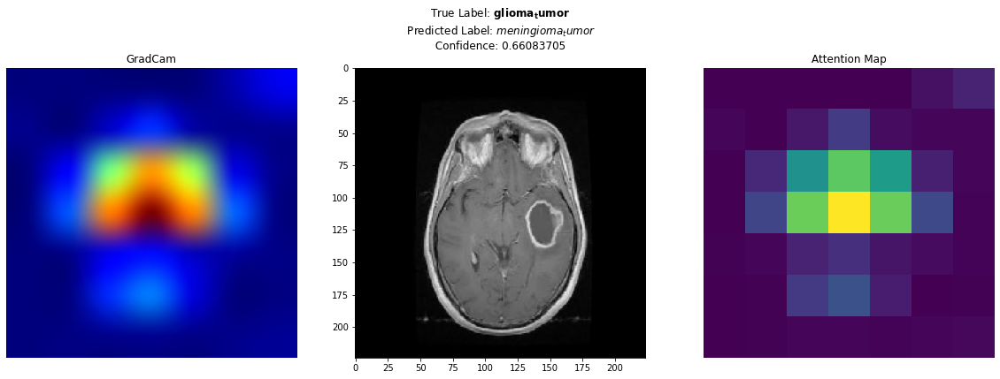

------------


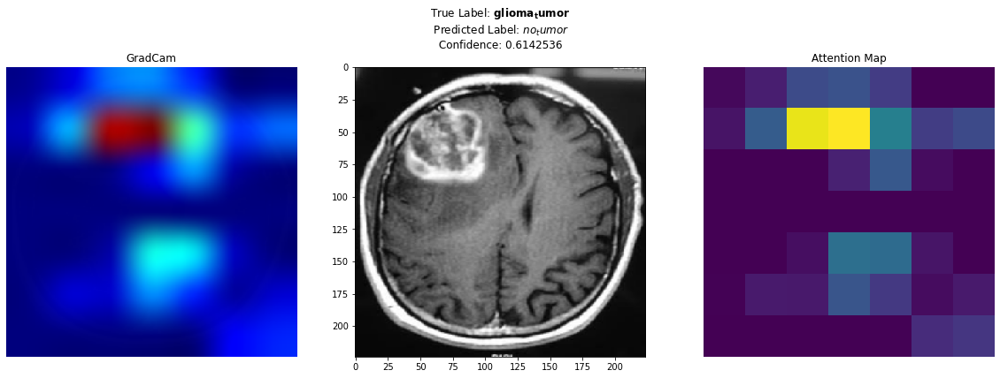

------------


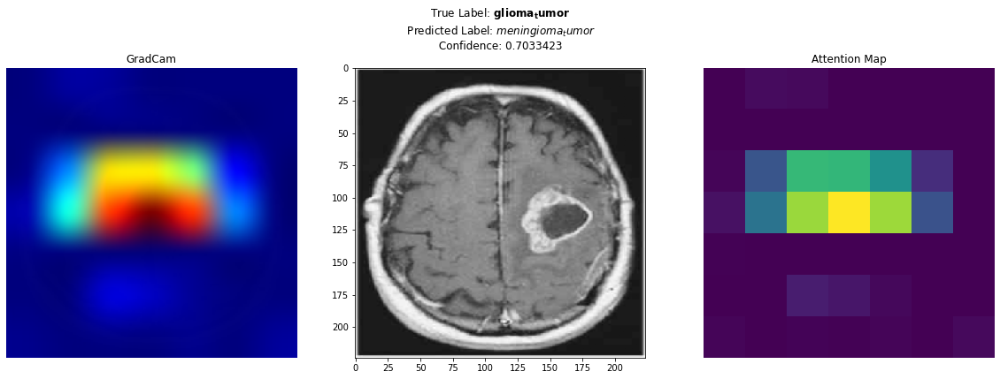

------------


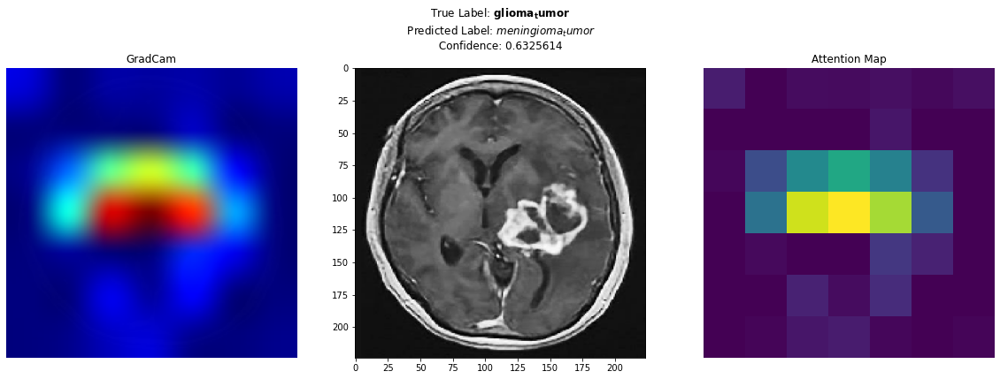

------------


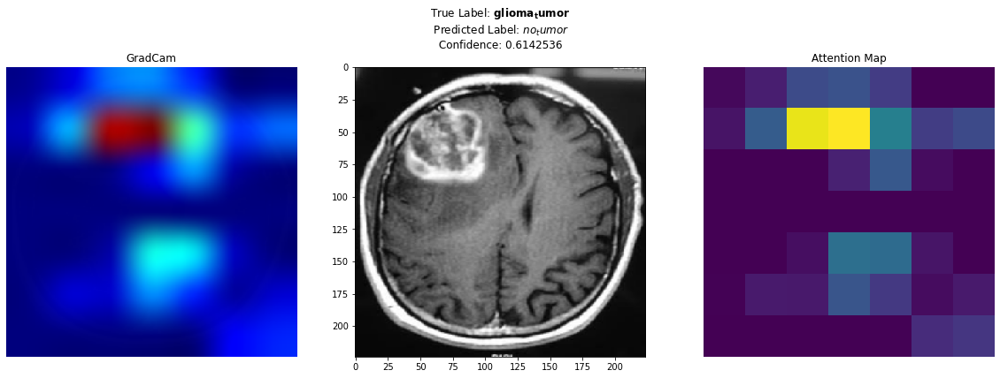

------------


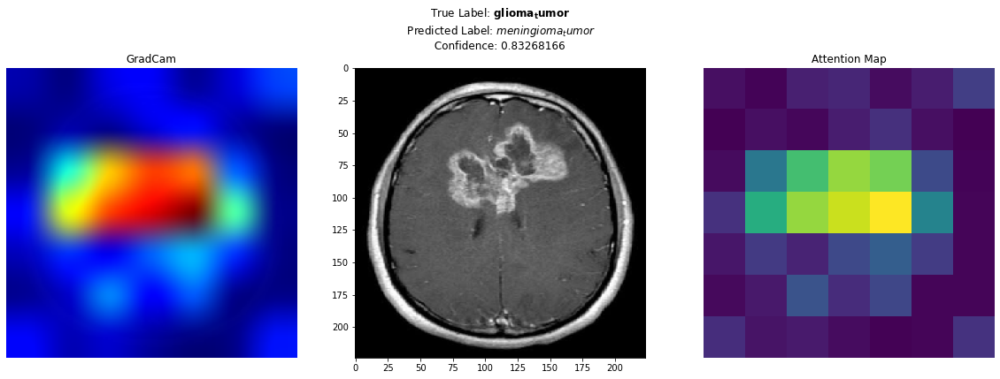

------------


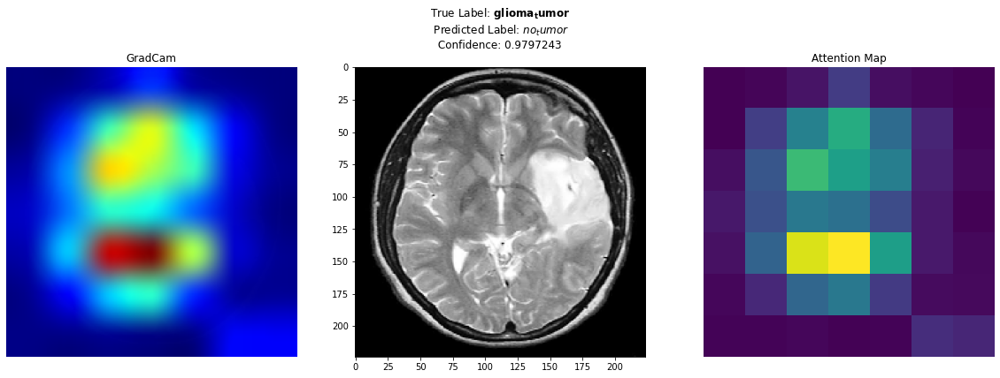

------------


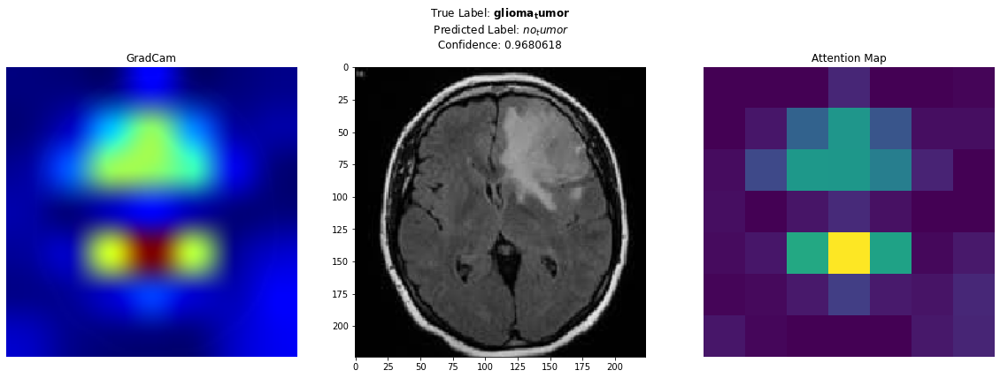

------------


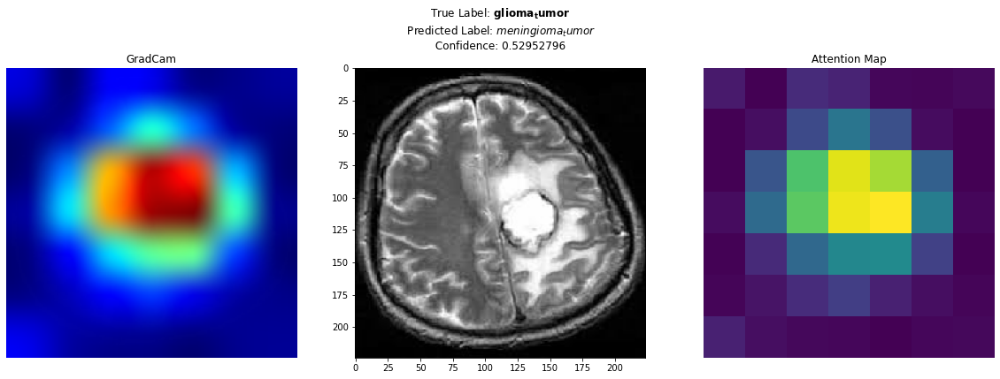

------------


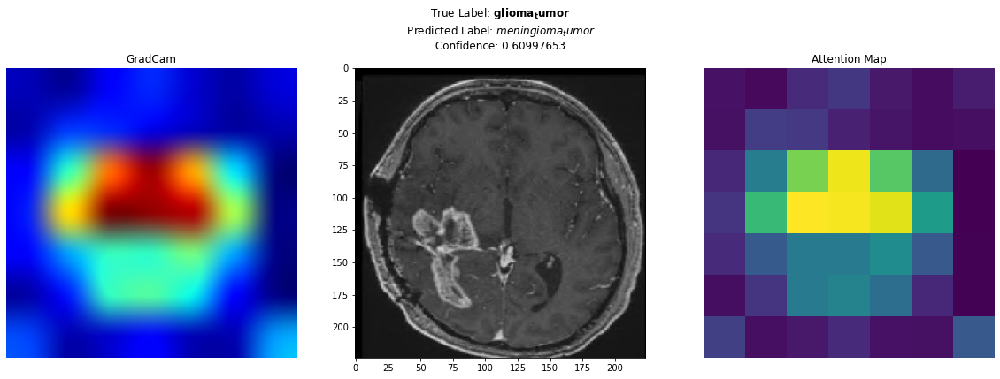

------------


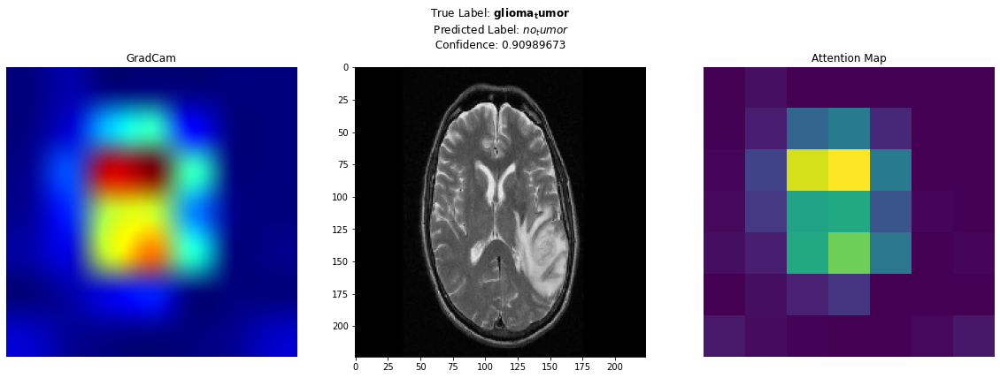

------------


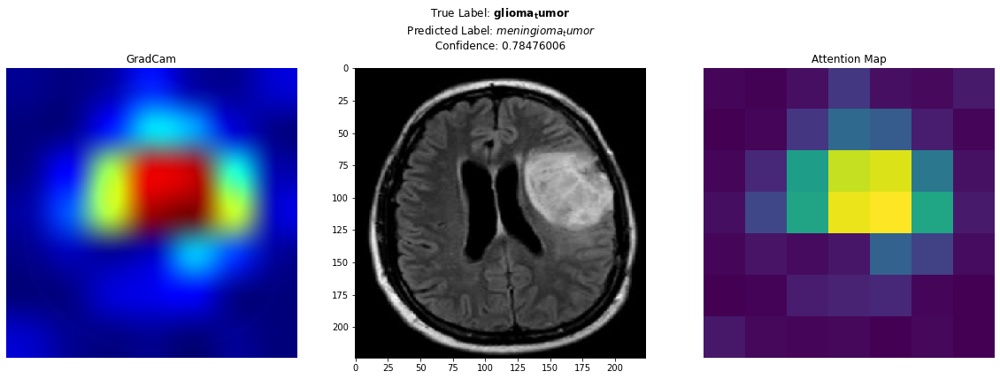

------------


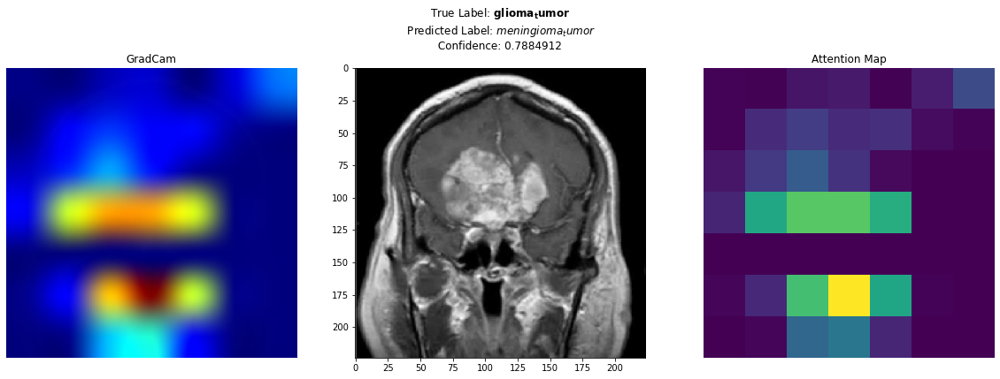

------------


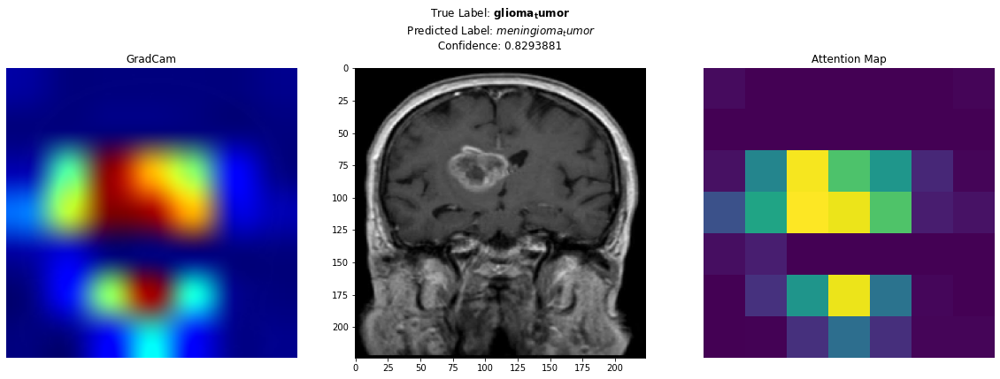

------------


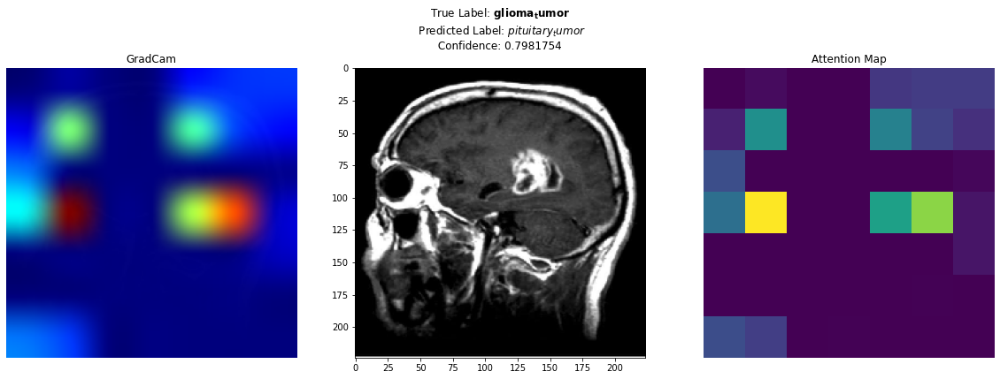

------------


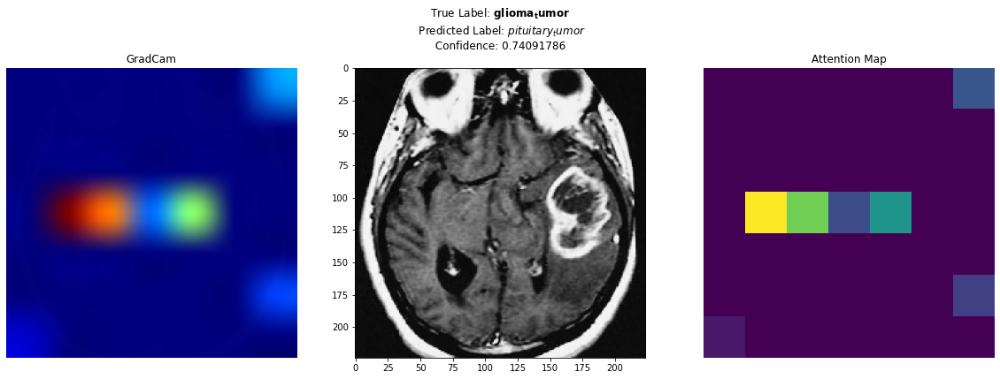

------------


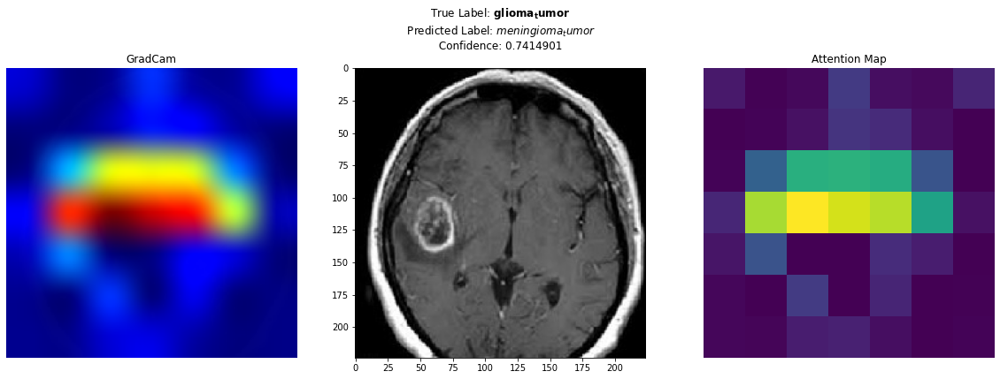

------------


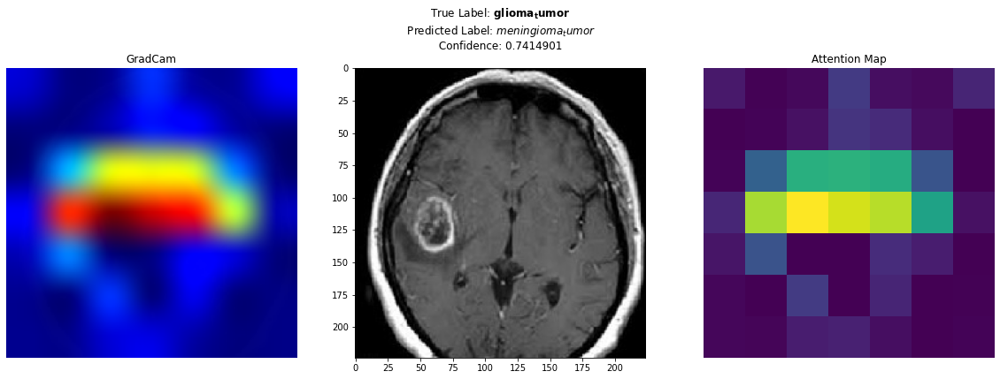

------------


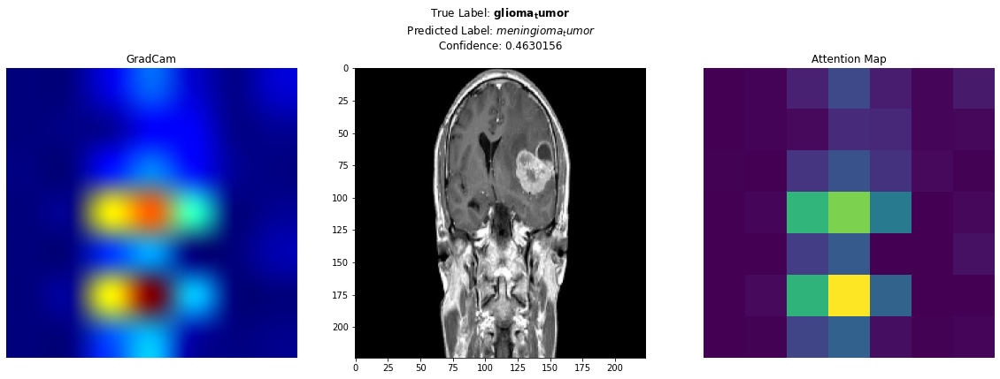

------------


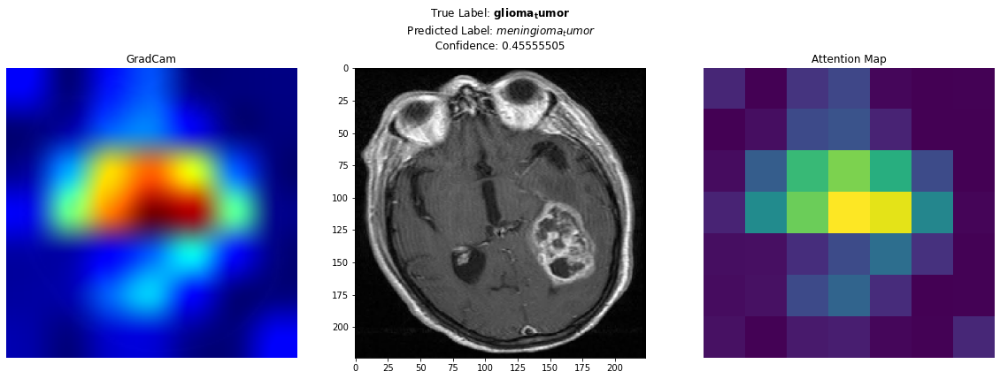

------------


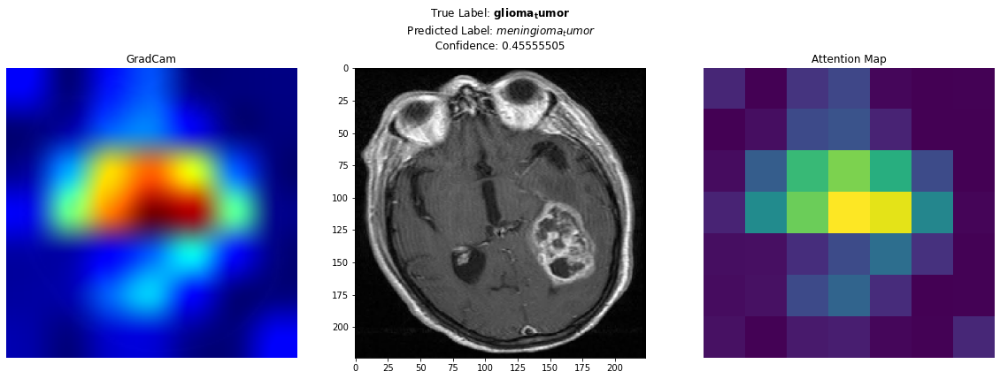

------------


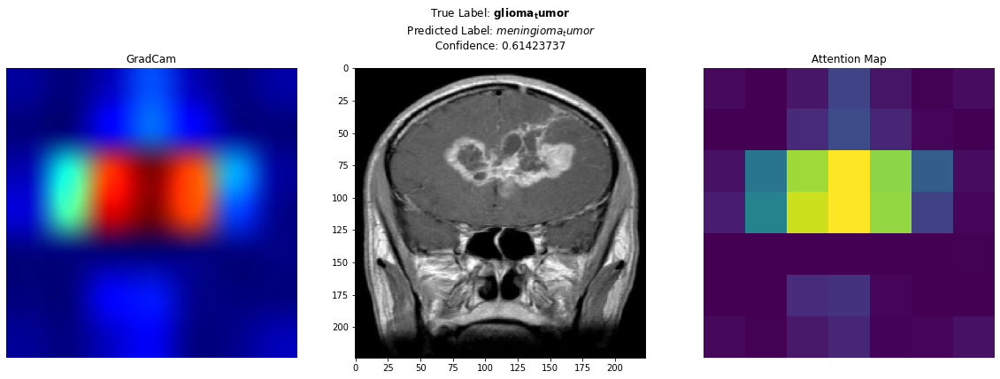

------------


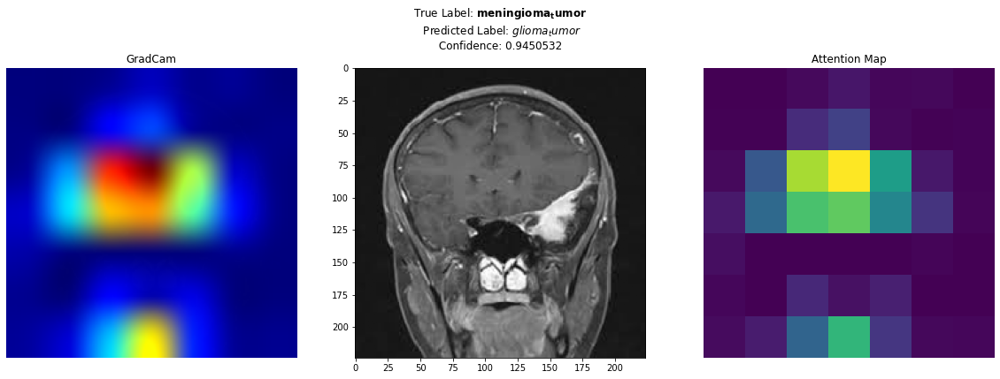

------------


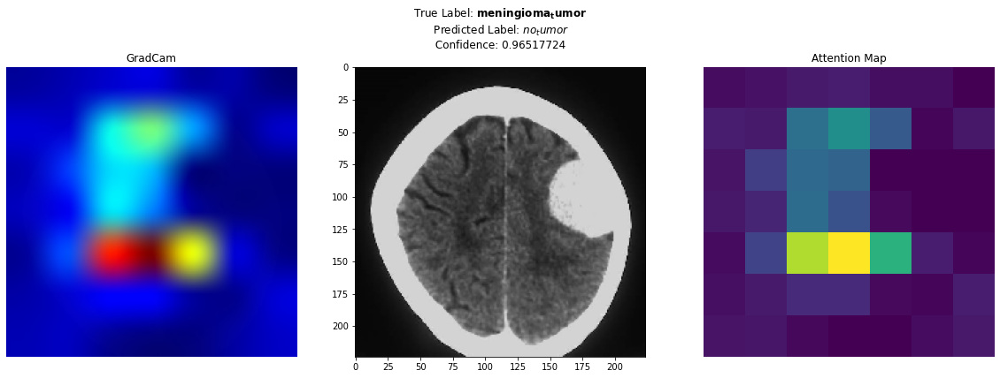

------------


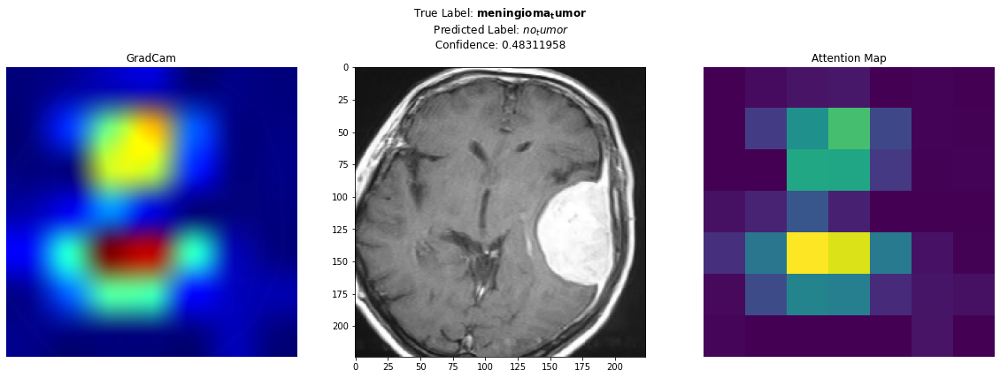

------------


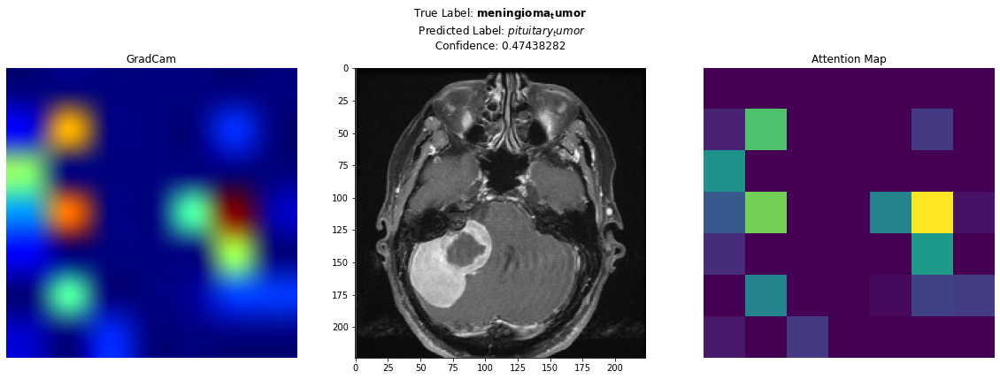

------------


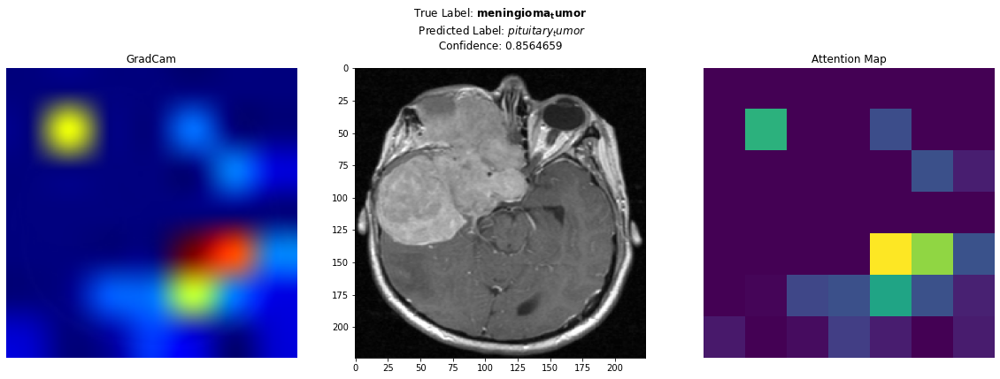

------------


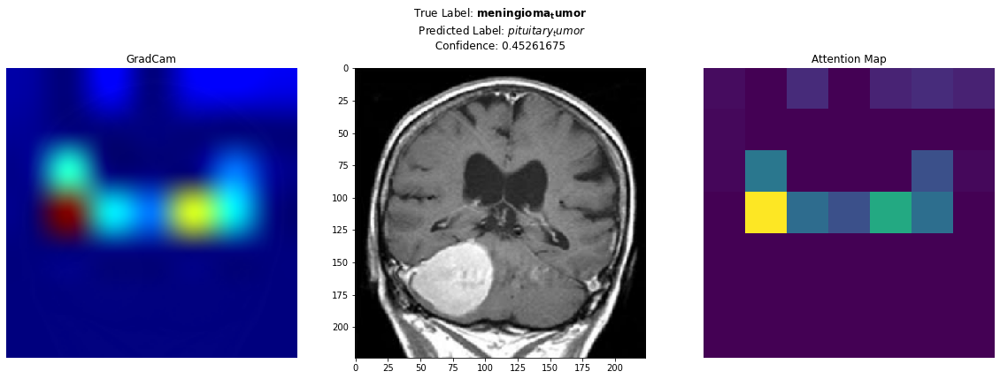

------------


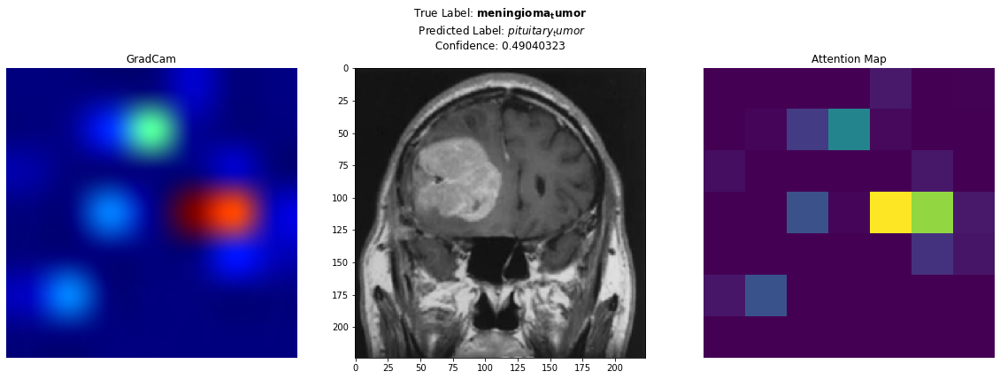

------------


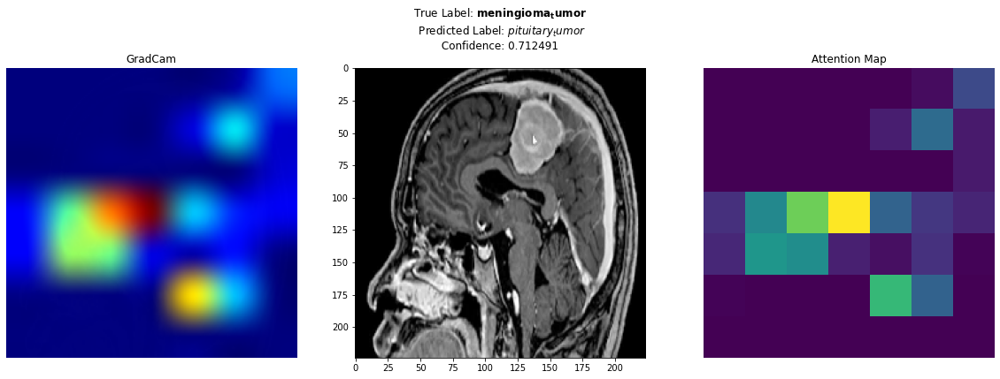

------------


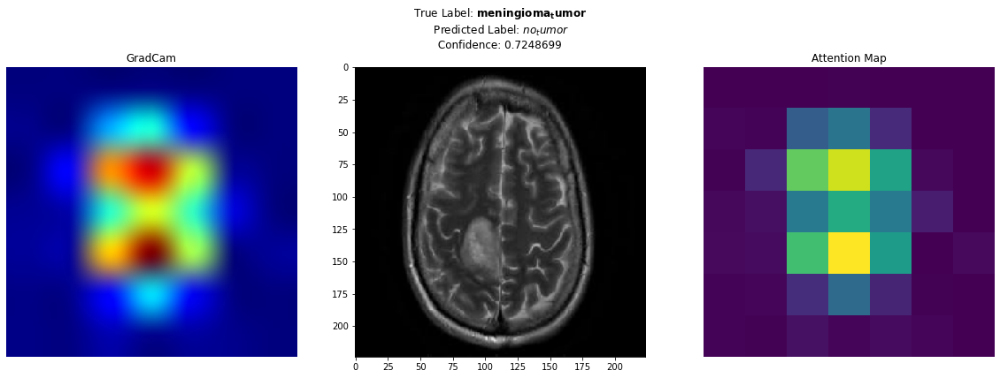

------------


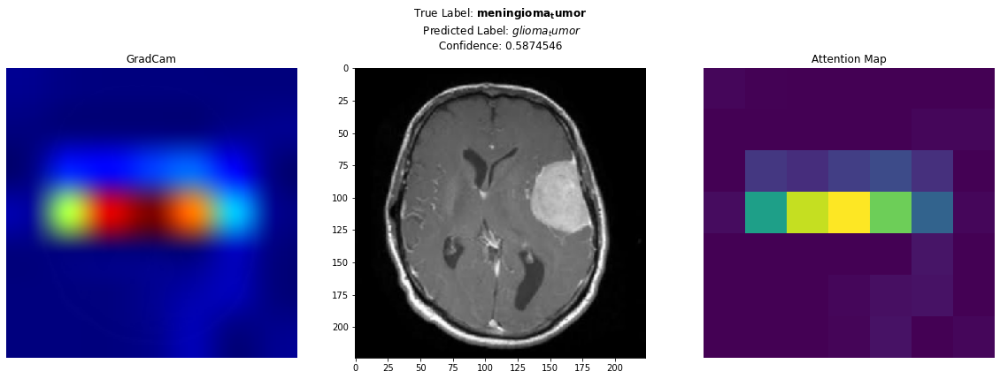

------------


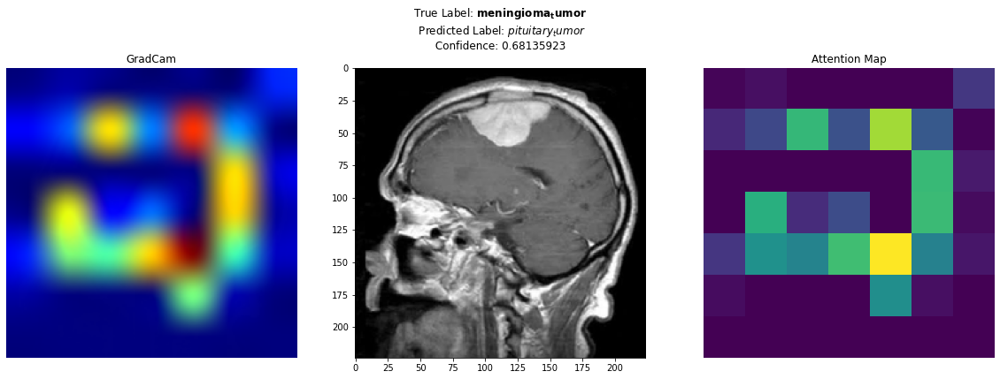

------------


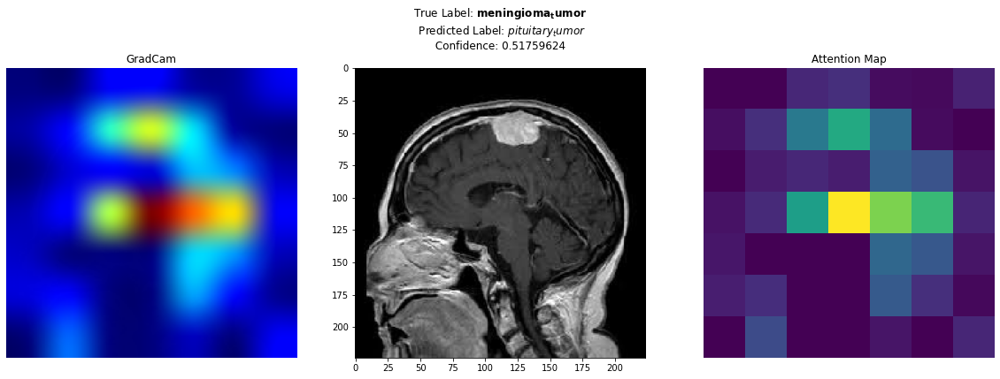

------------


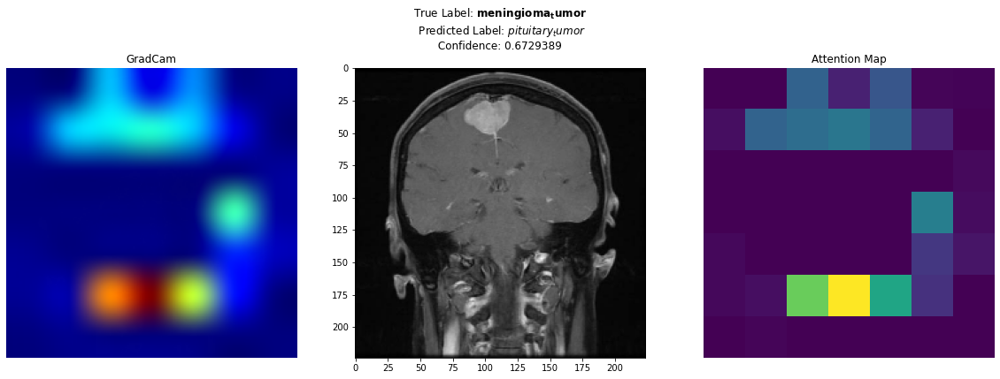

------------


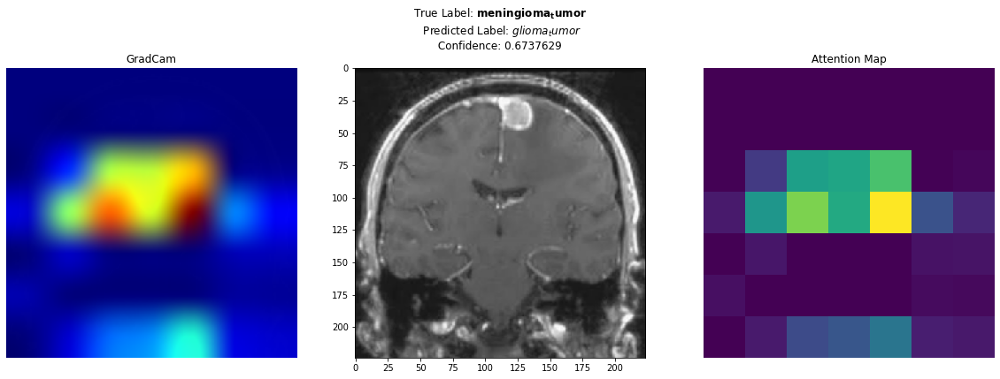

------------


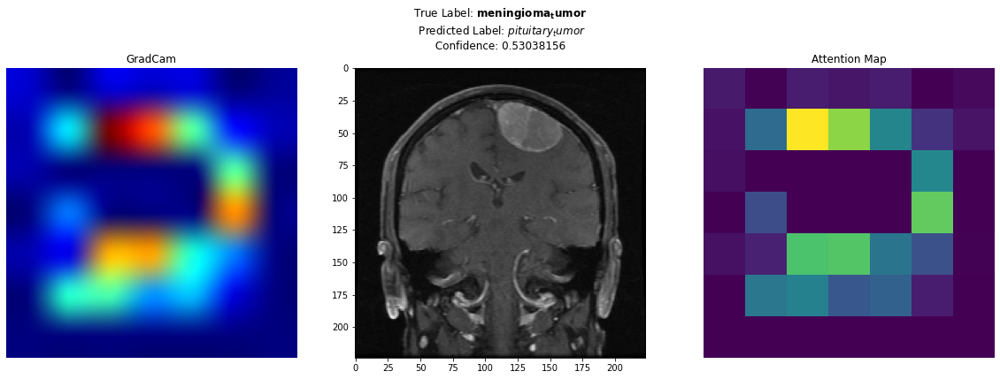

------------


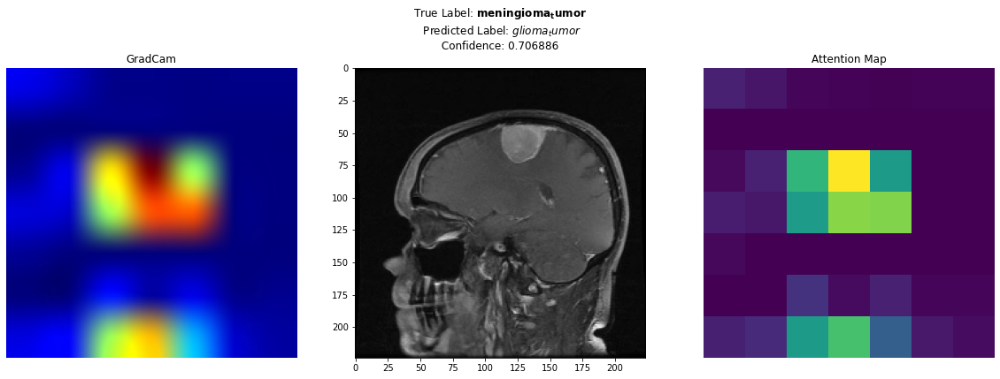

------------


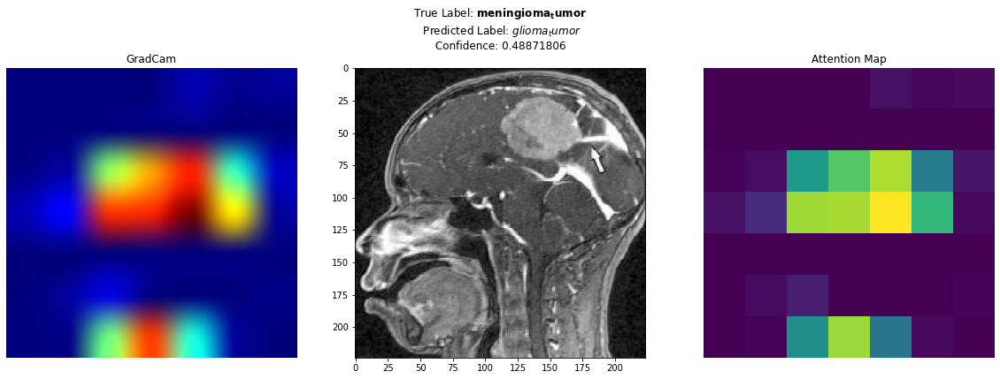

------------


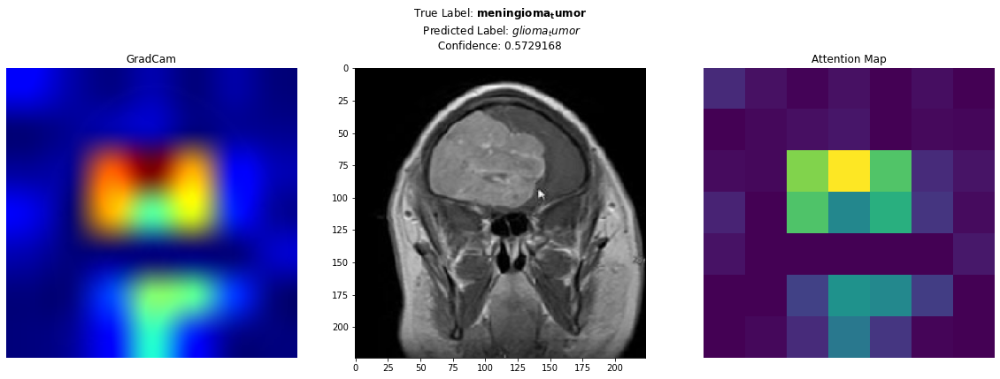

------------


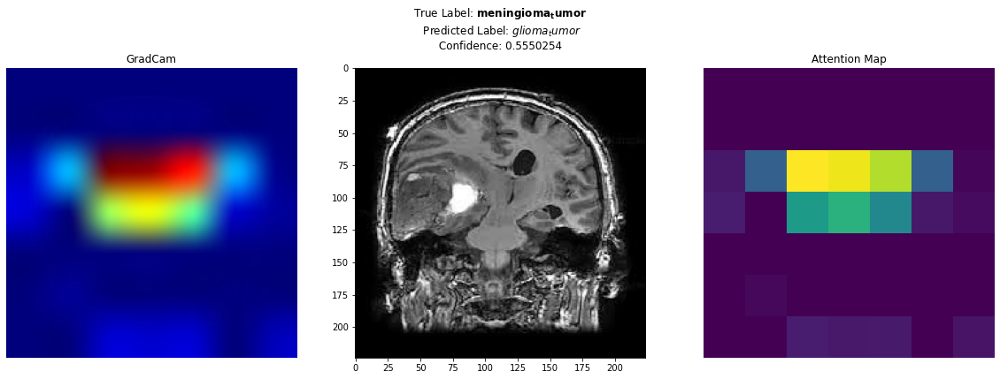

------------


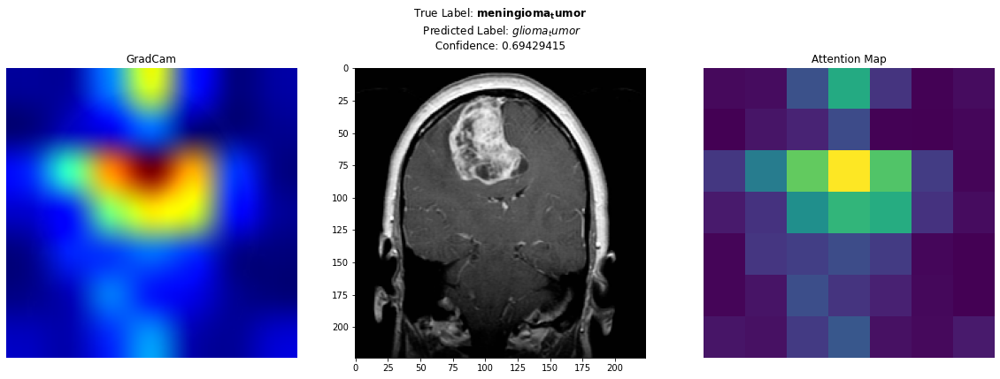

------------


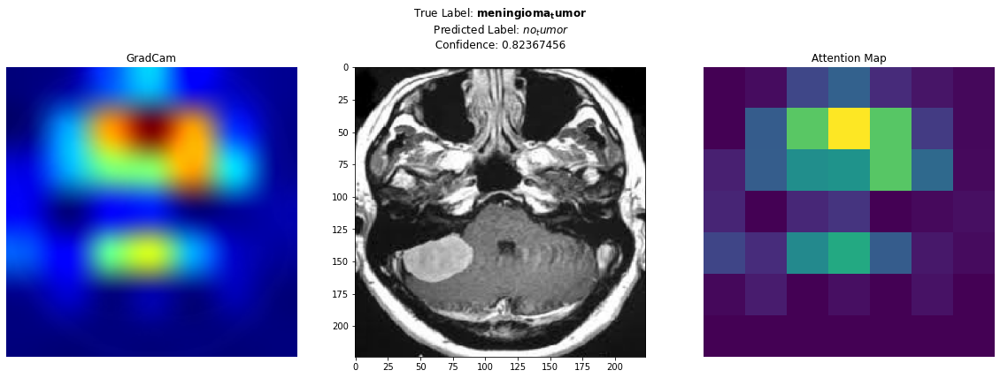

------------


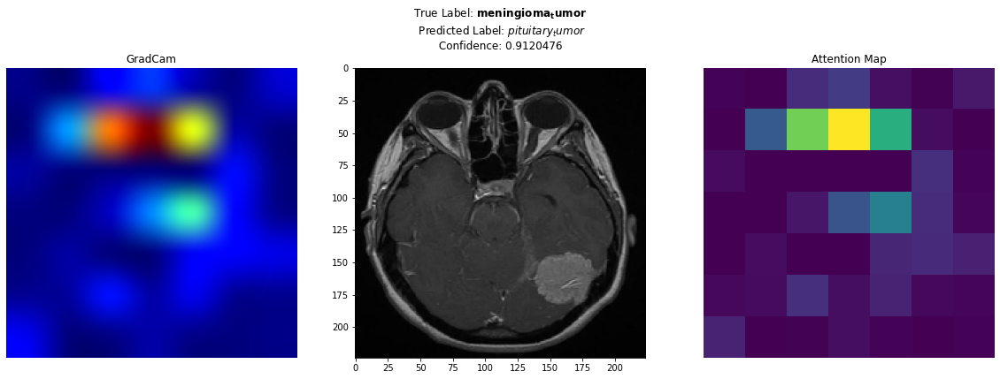

------------


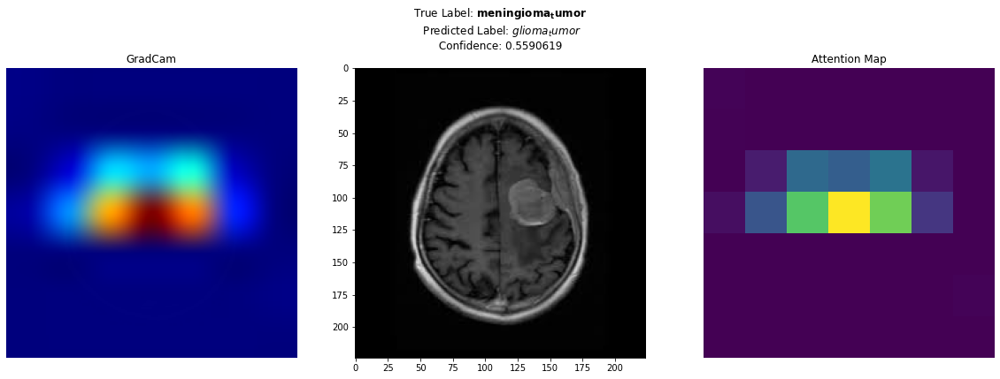

------------


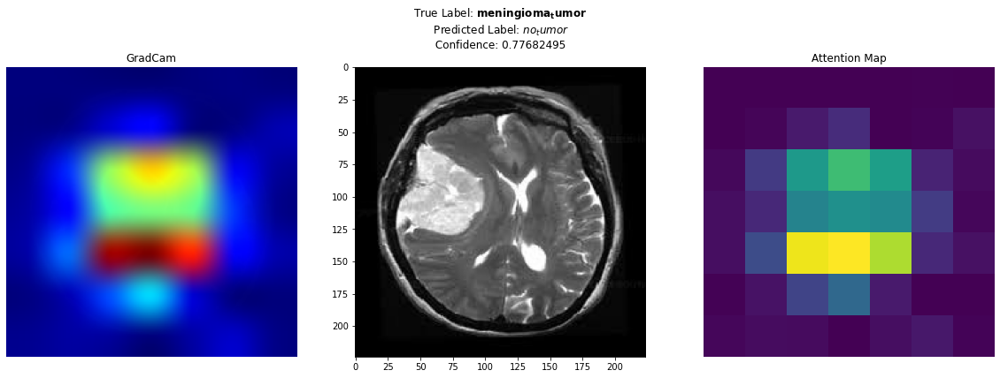

------------


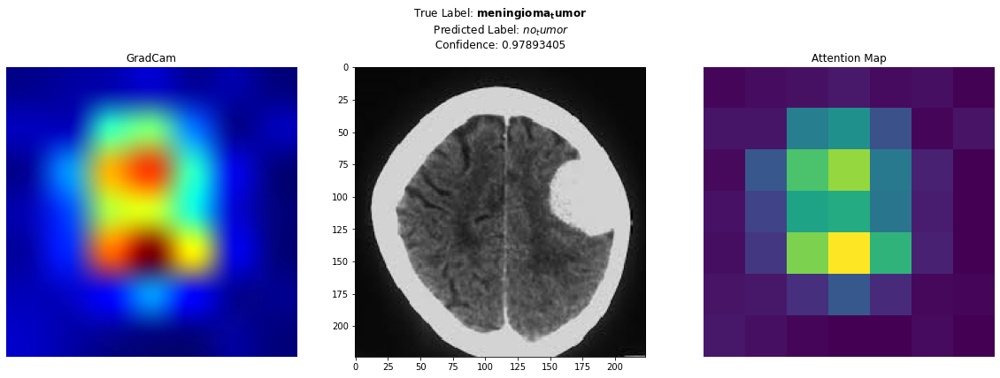

------------


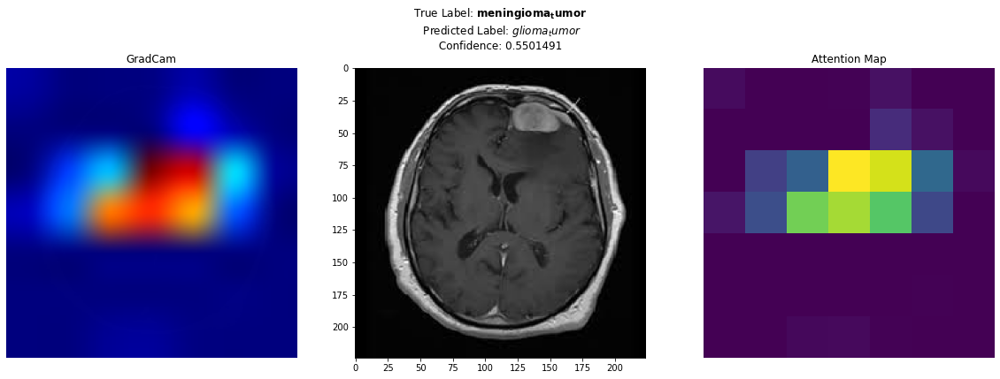

------------


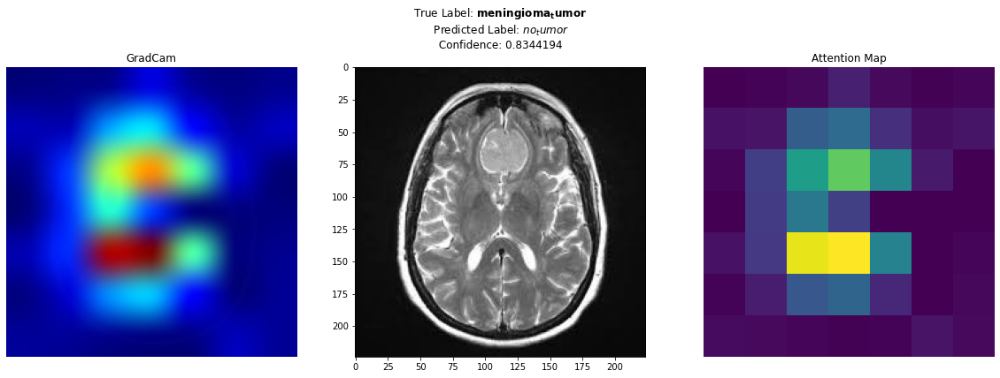

------------


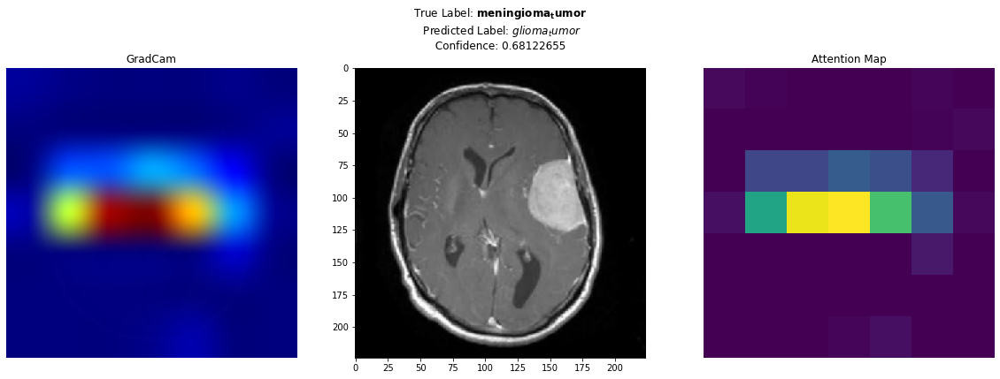

------------


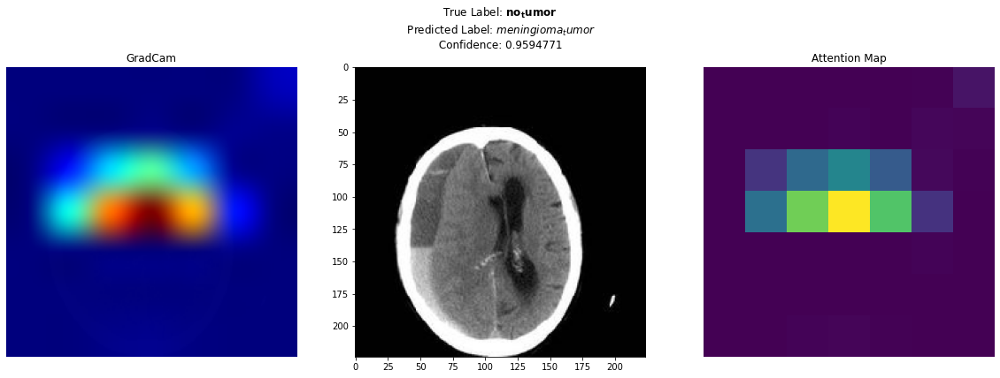

------------


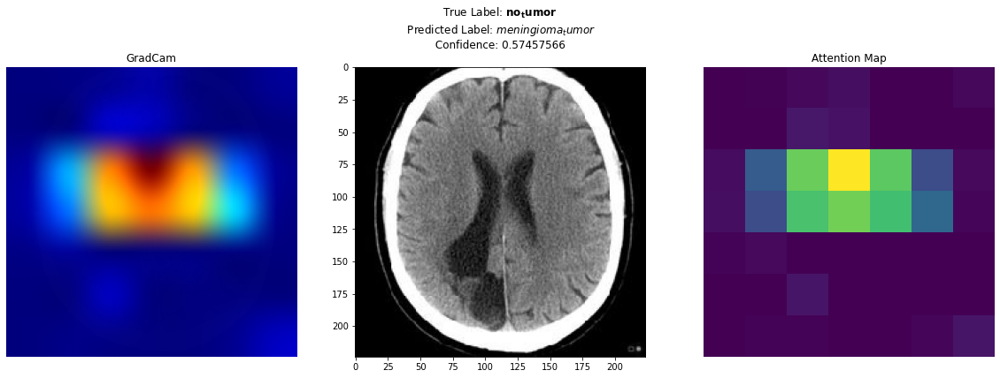

------------


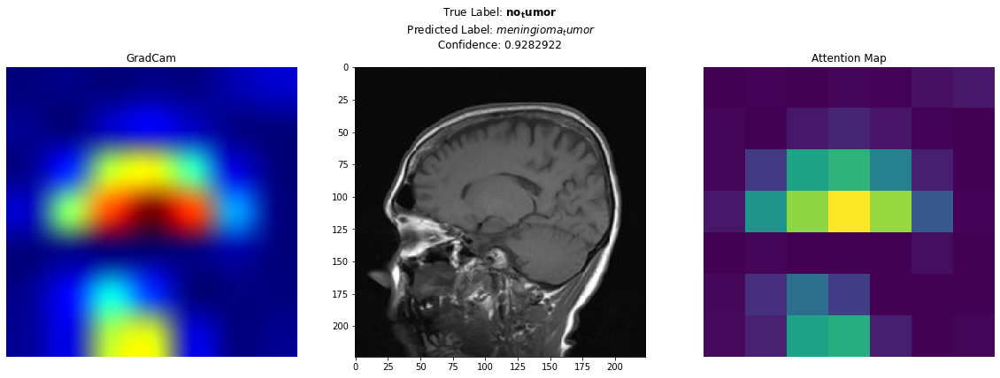

------------


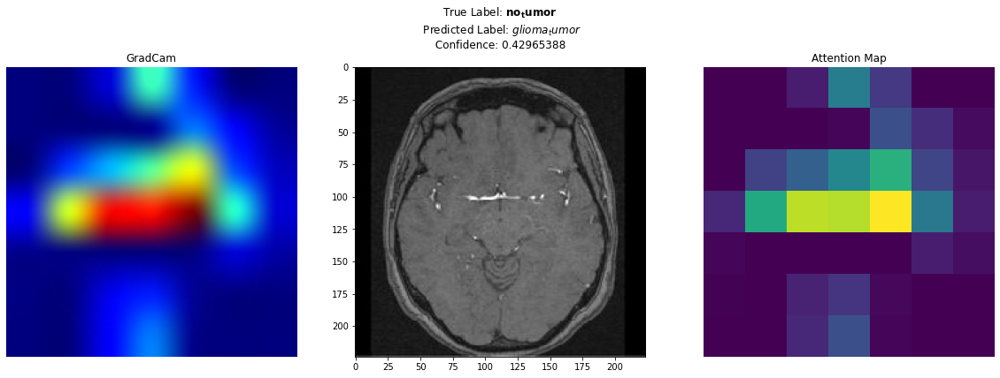

------------


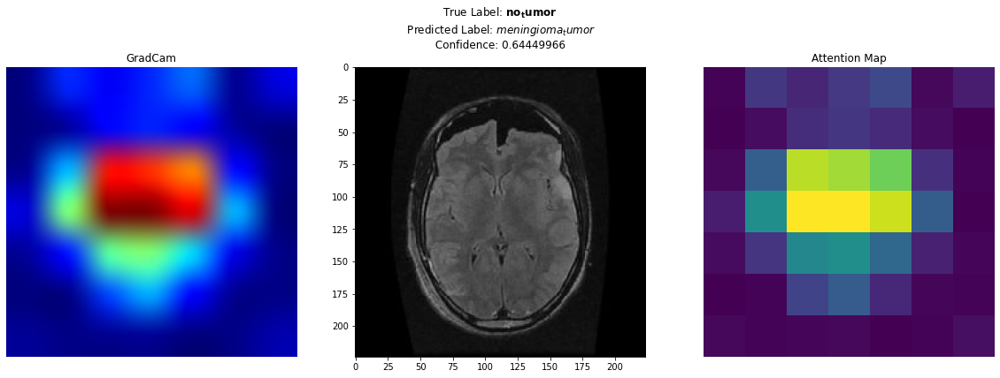

------------


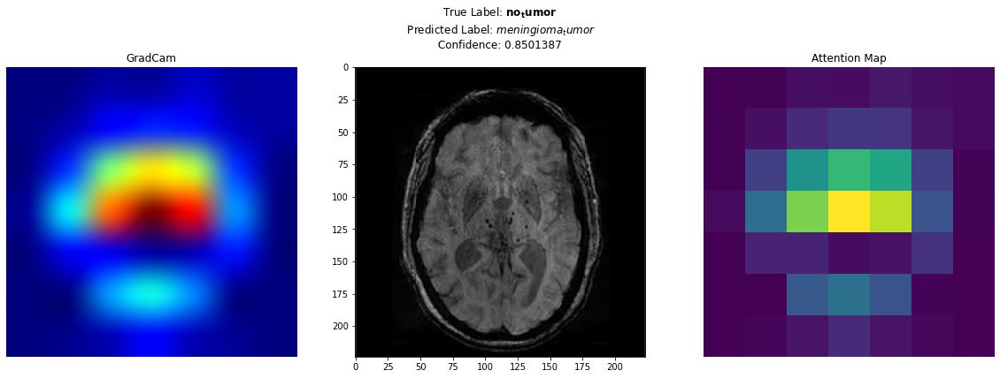

------------


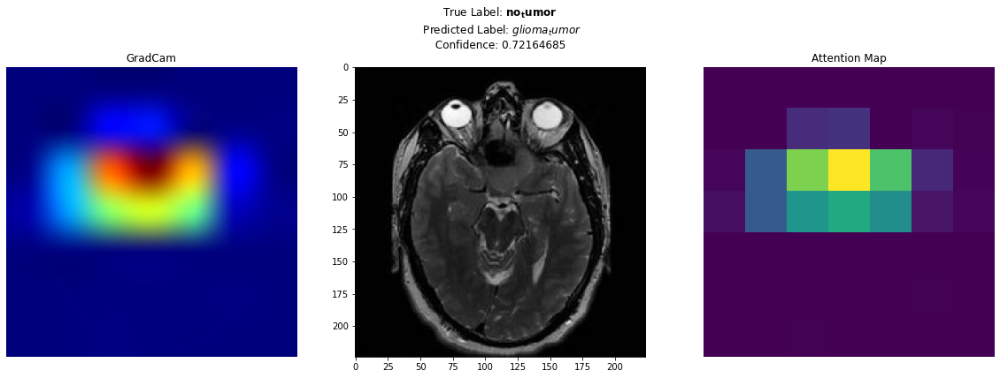

------------


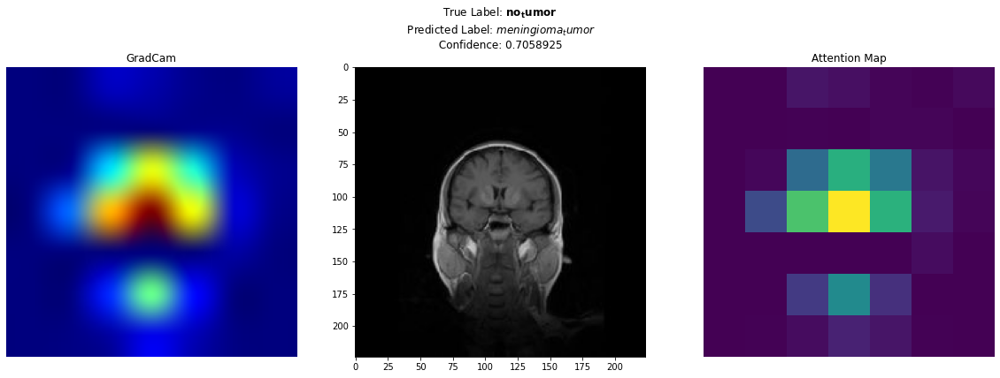

------------


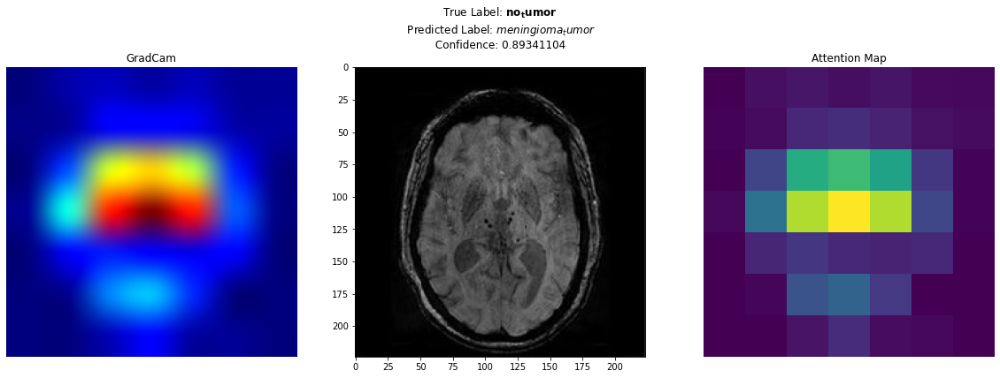

------------


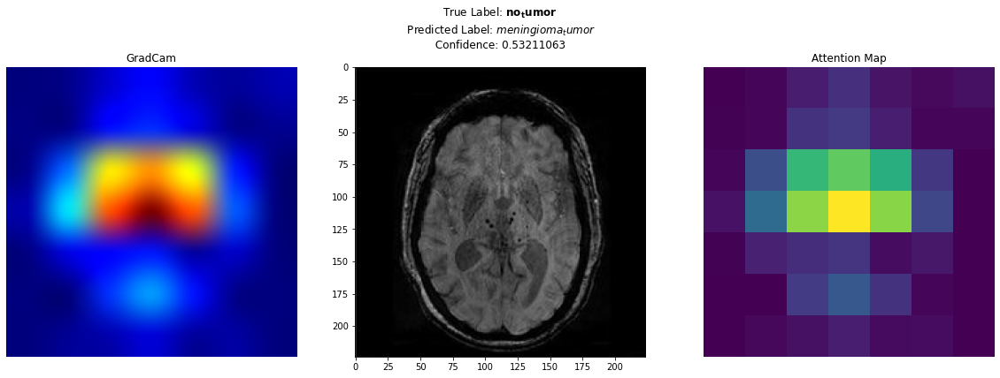

------------


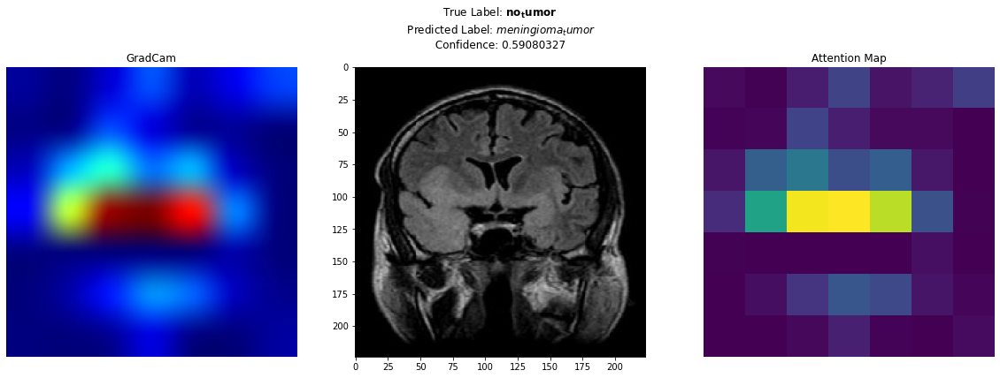

------------


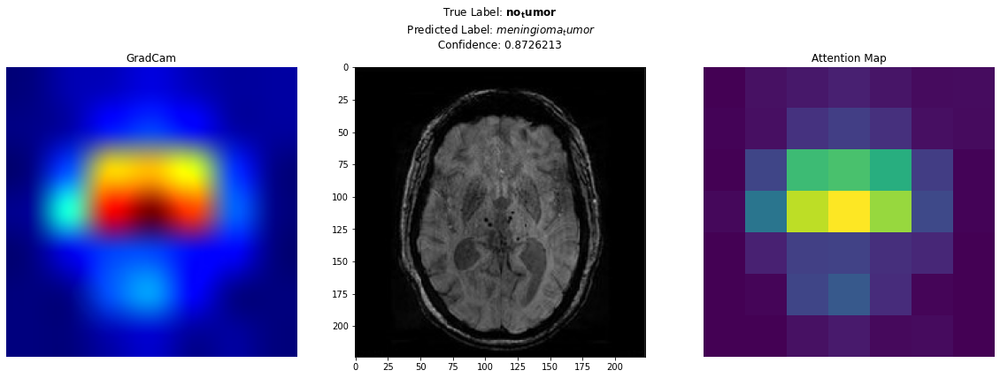

------------


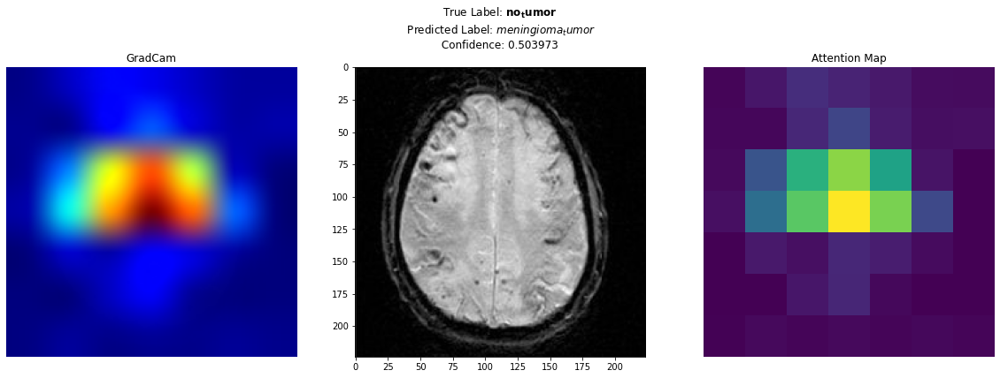

------------


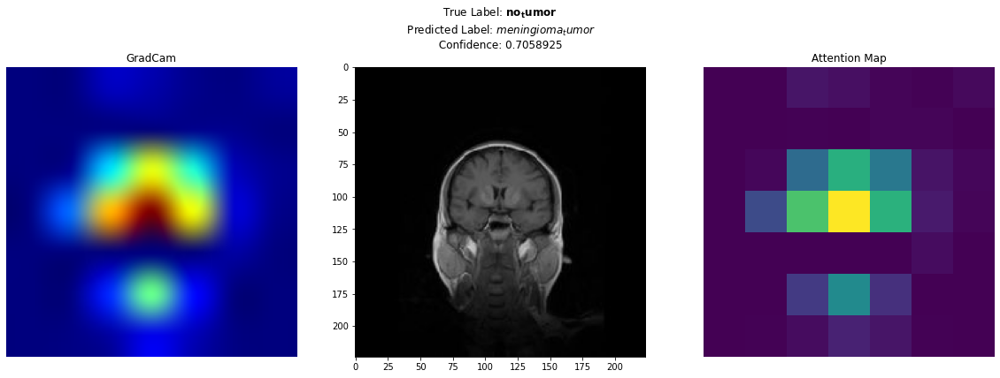

------------


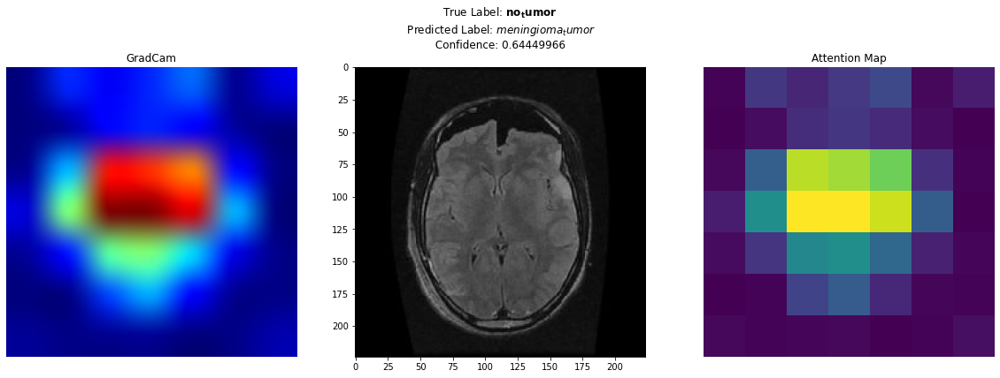

------------


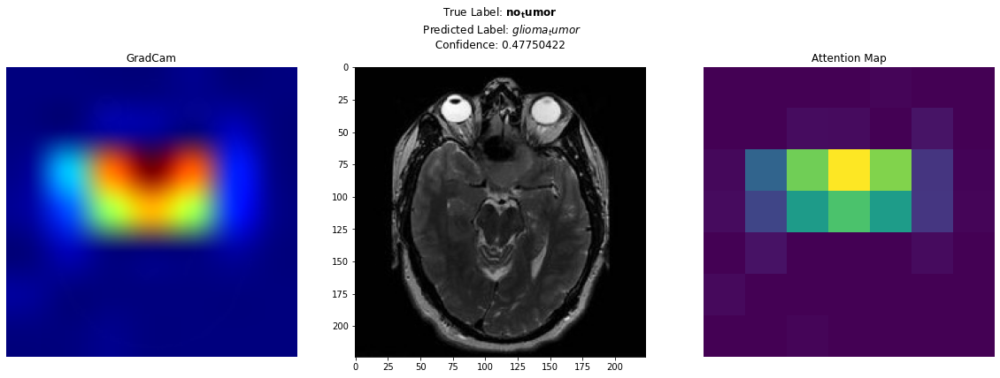

------------


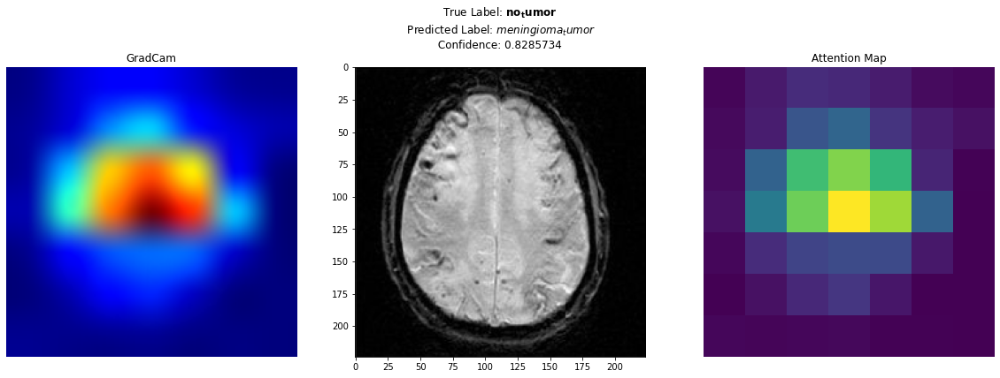

------------


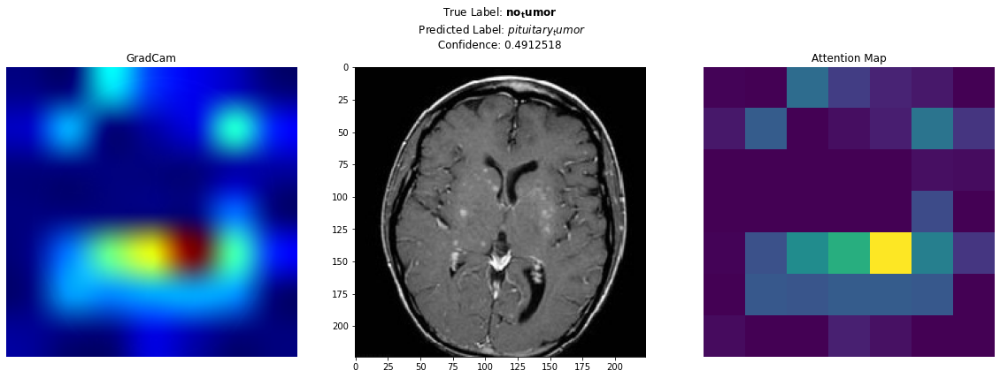

------------


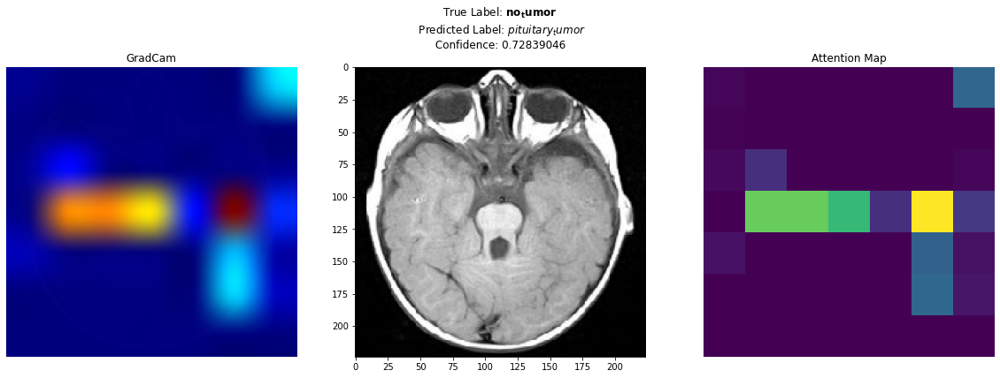

------------


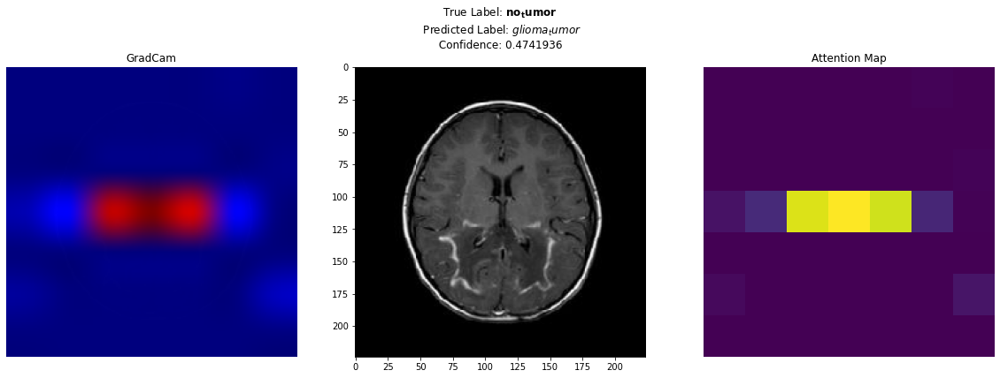

------------


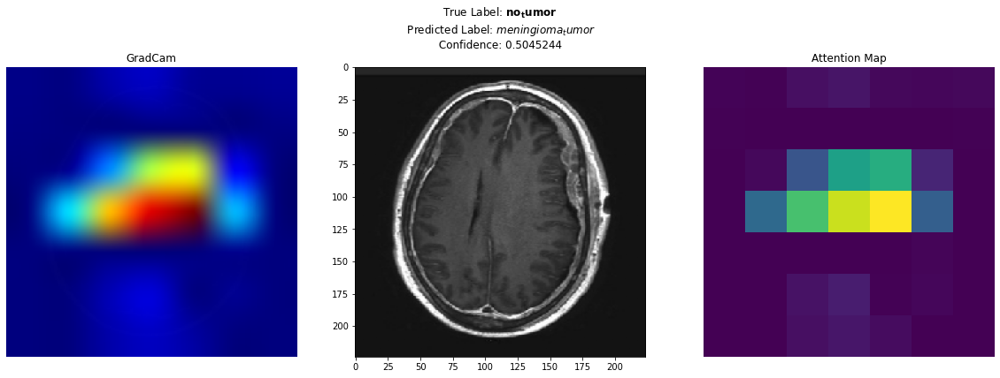

------------


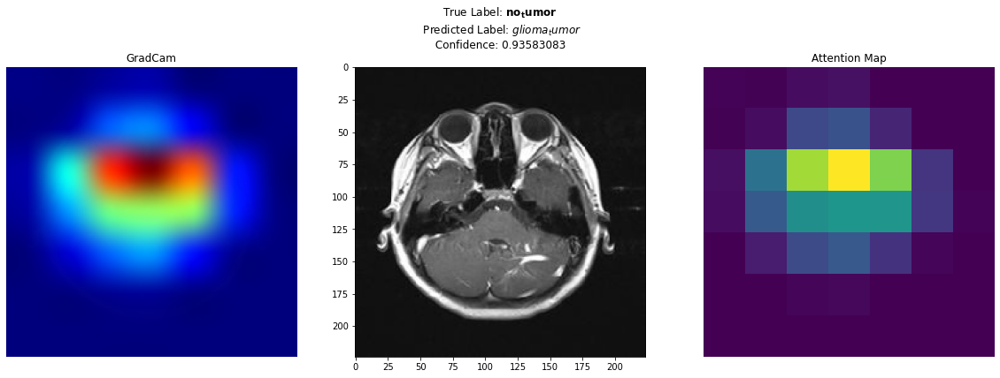

------------


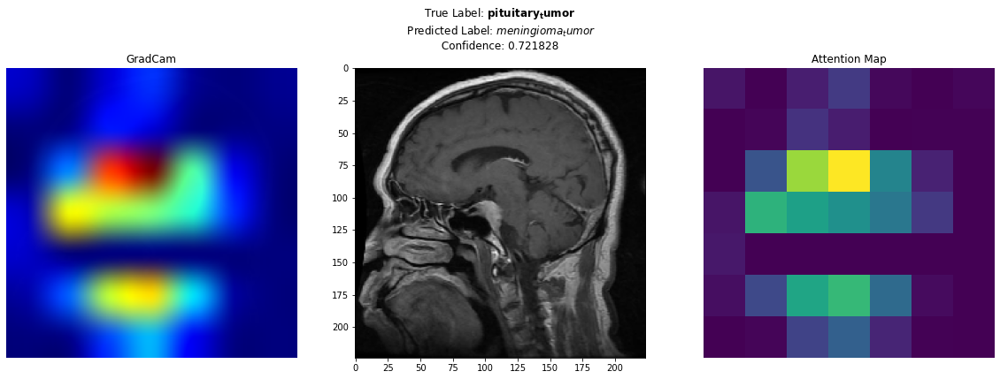

------------


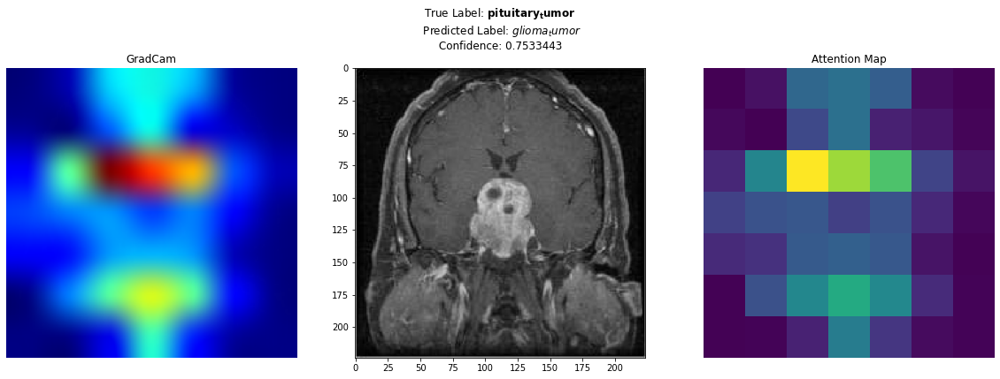

------------


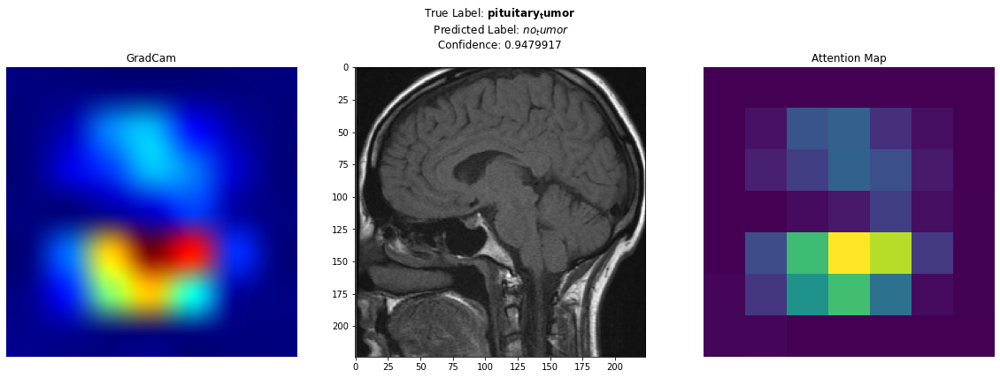

------------


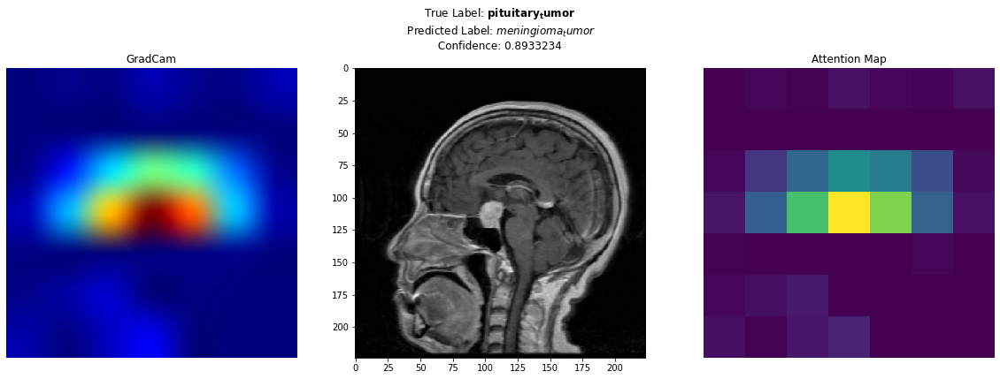

------------


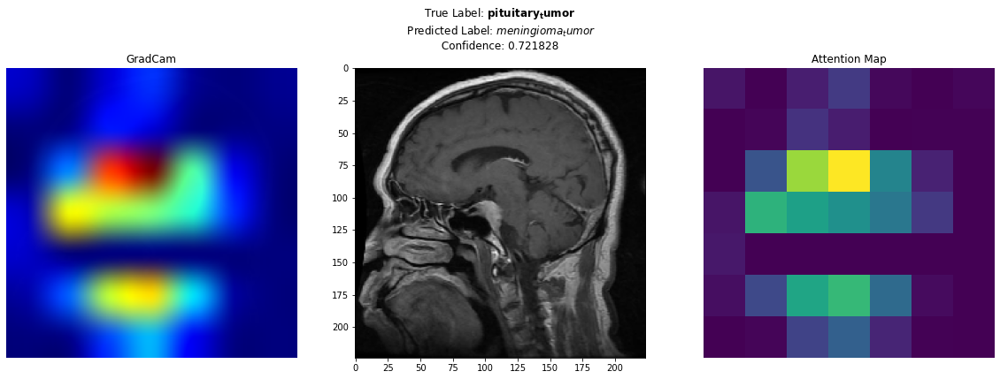

------------


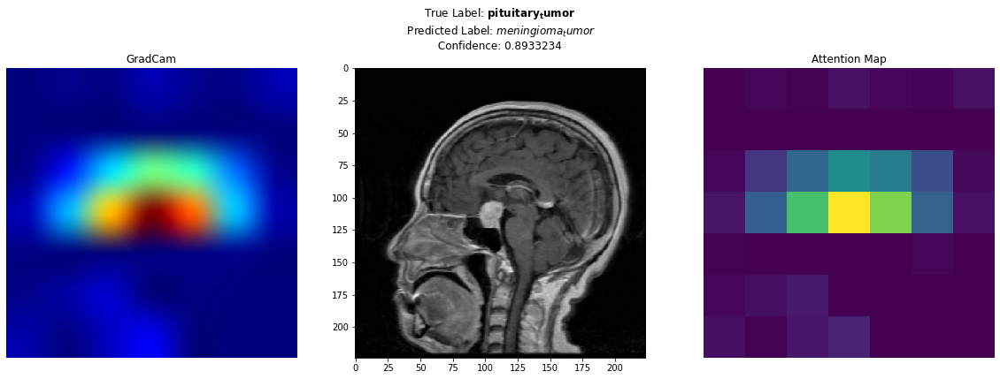

------------


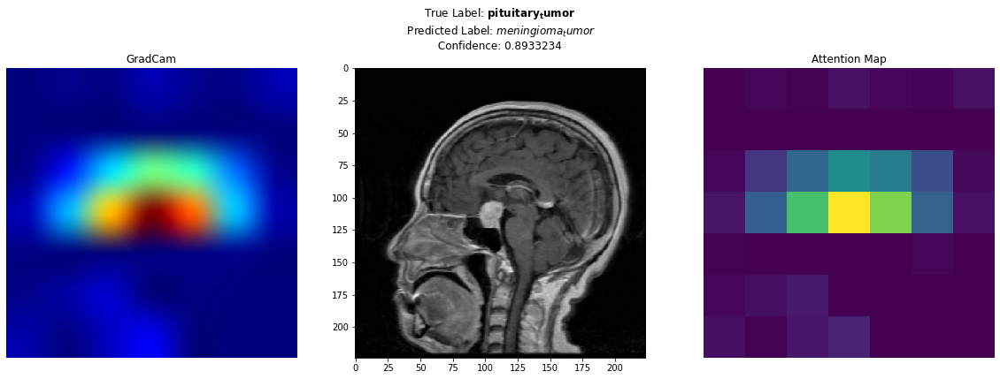

------------


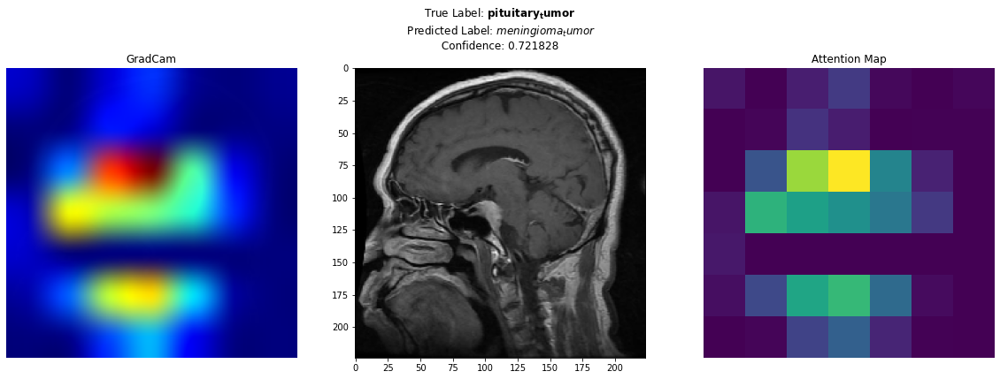

------------


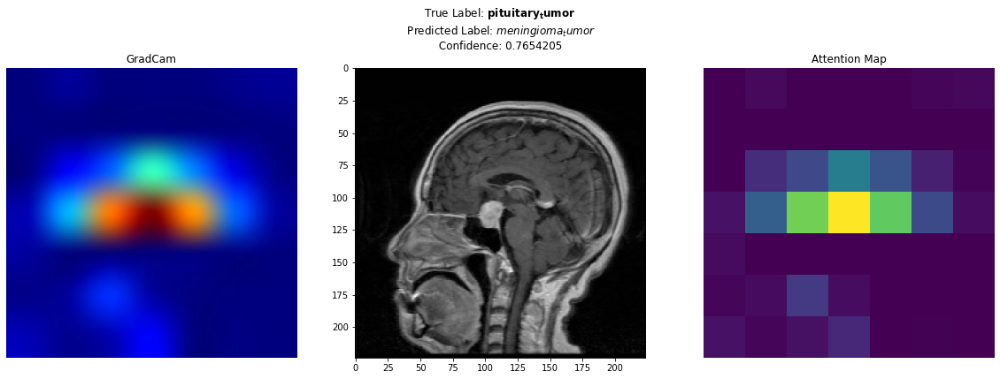

------------


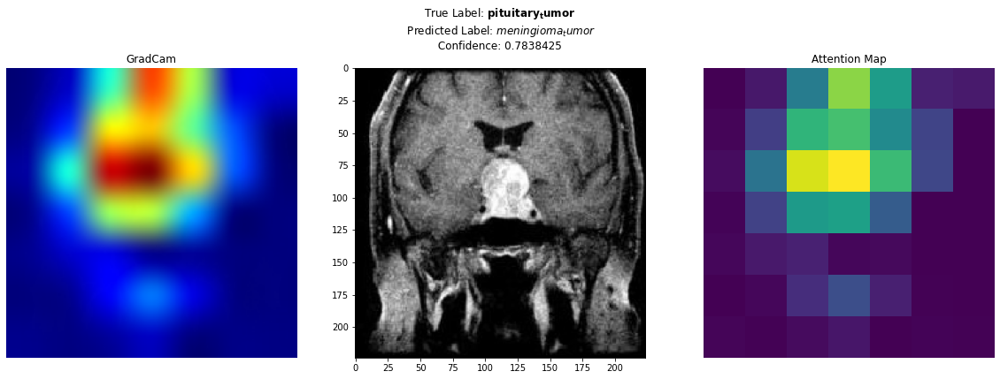

------------


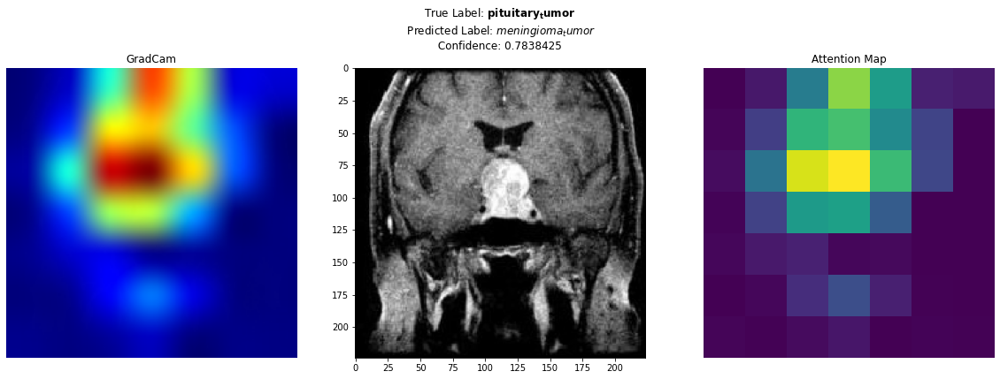

------------


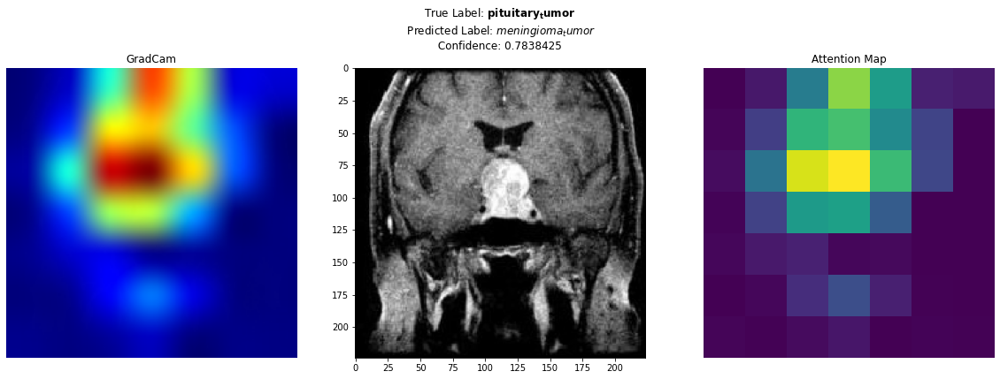

------------


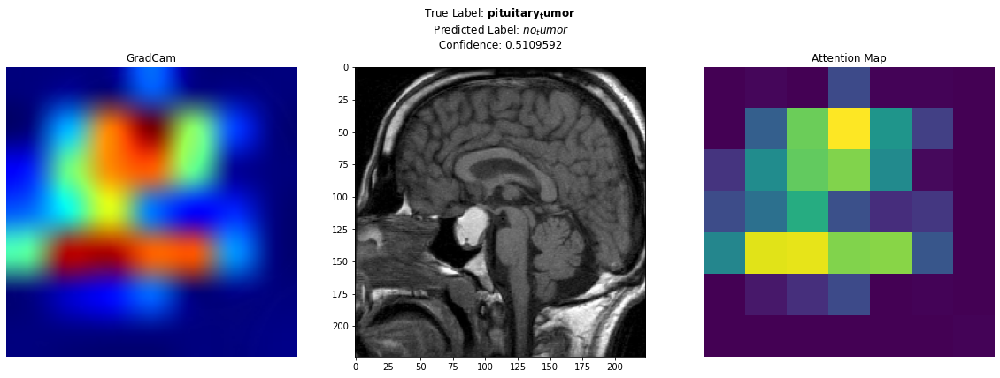

------------


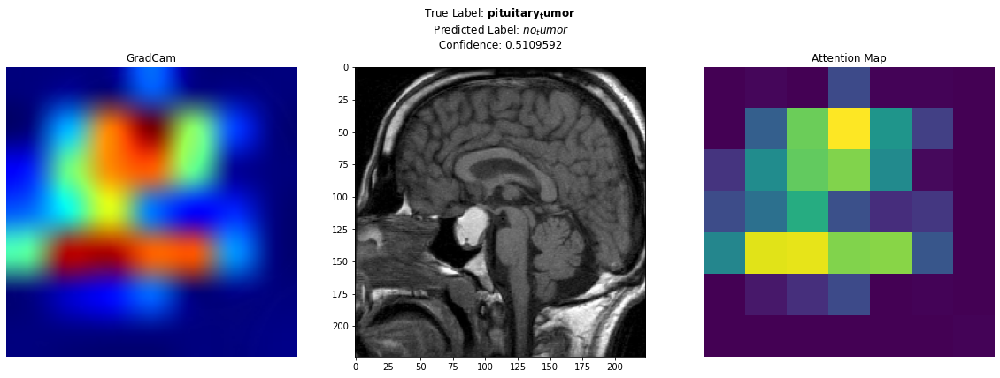

------------


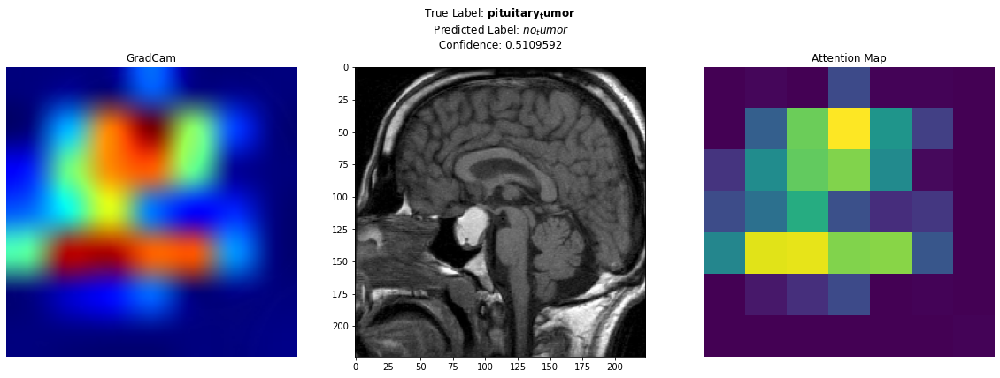

------------


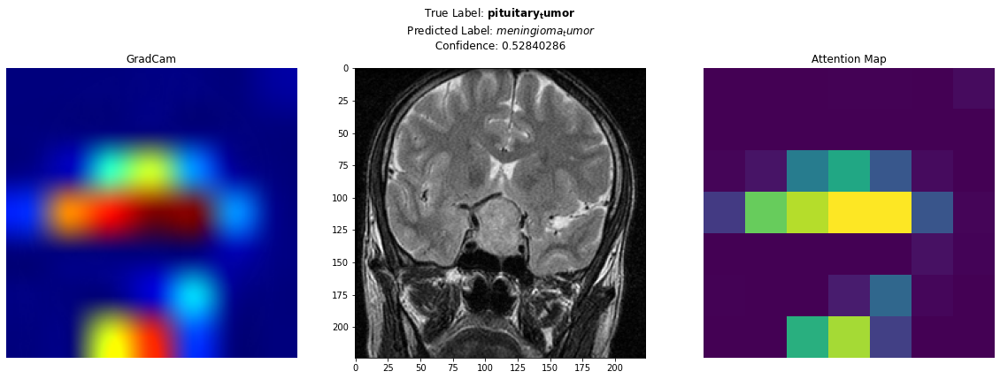

------------


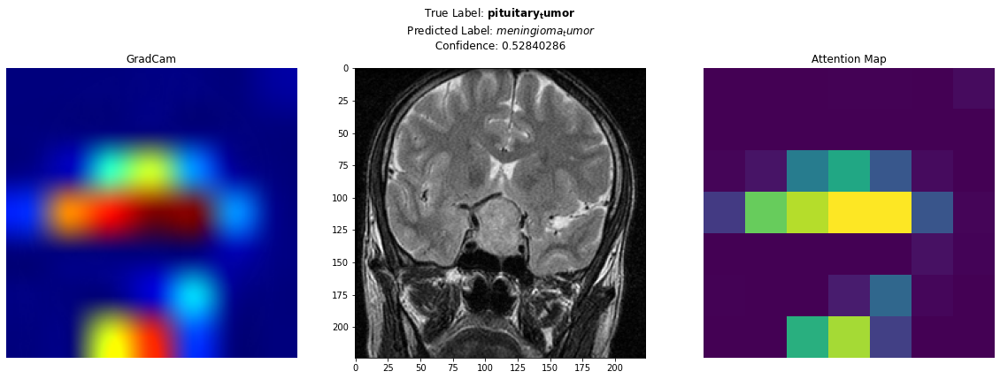

------------


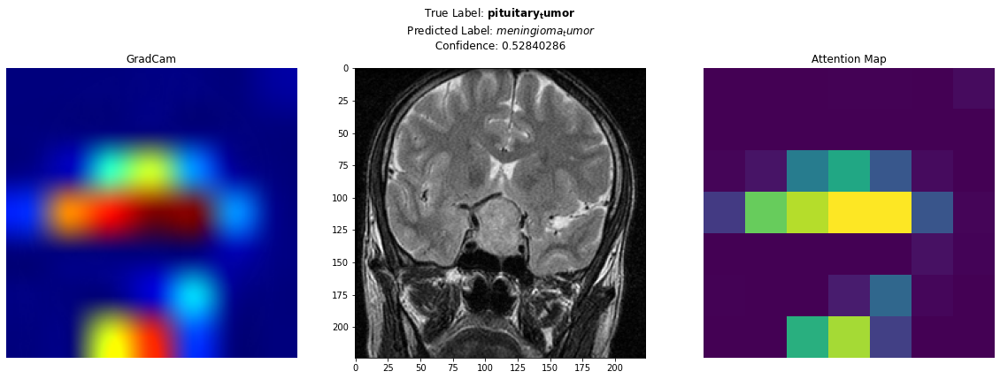

------------


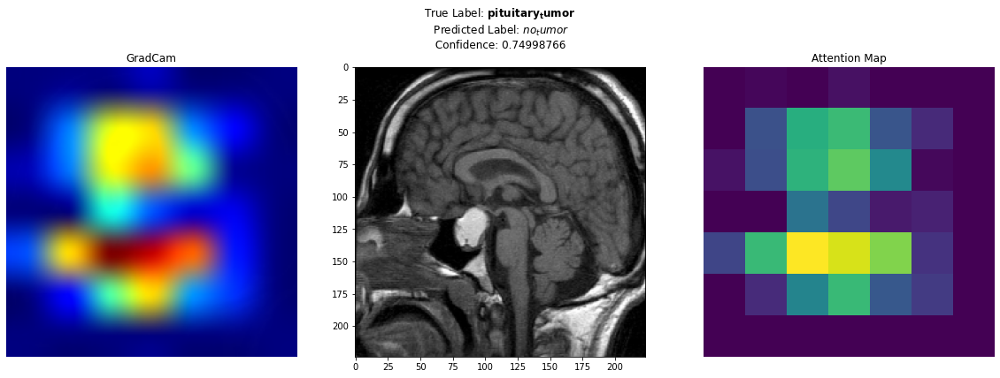

------------


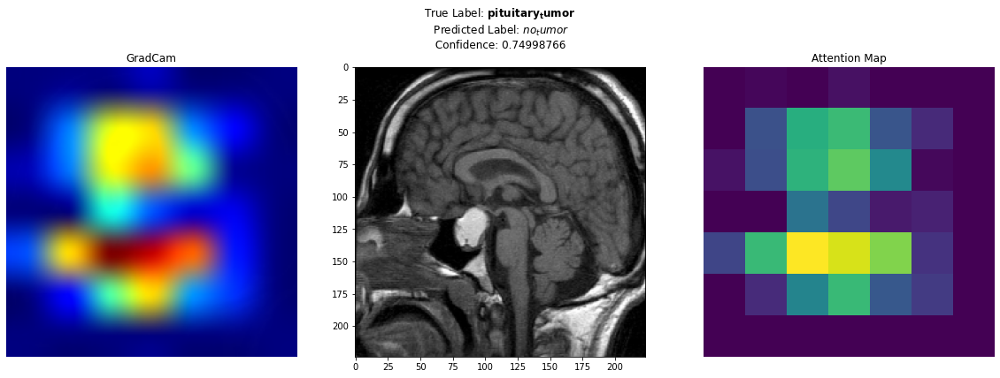

------------


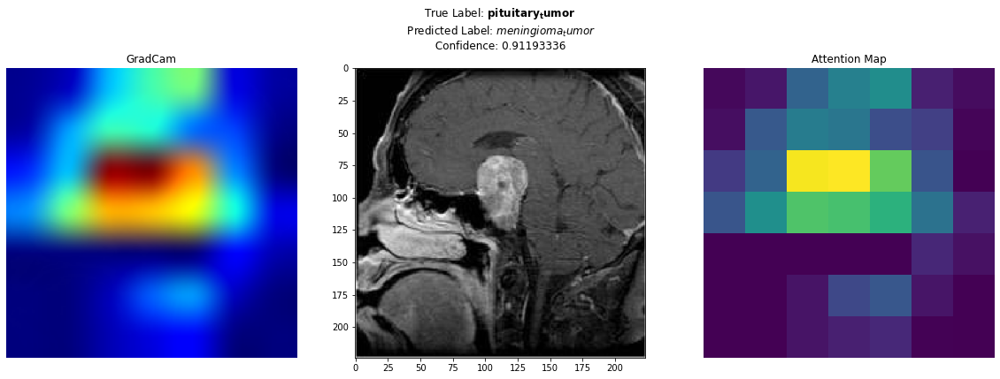

------------


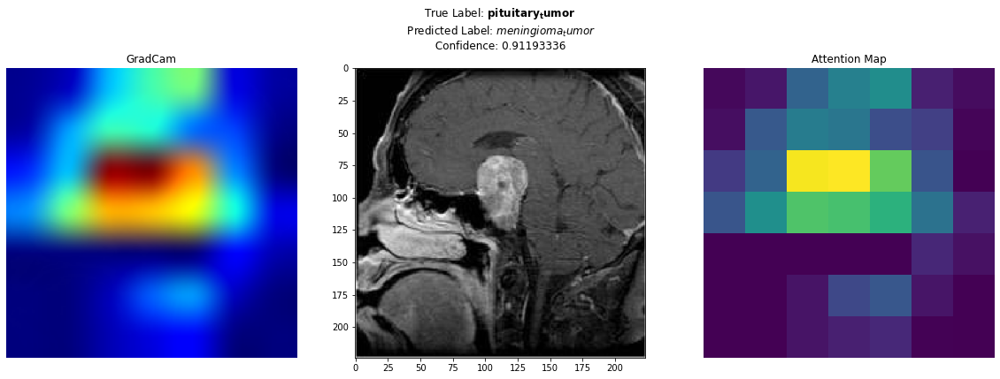

------------


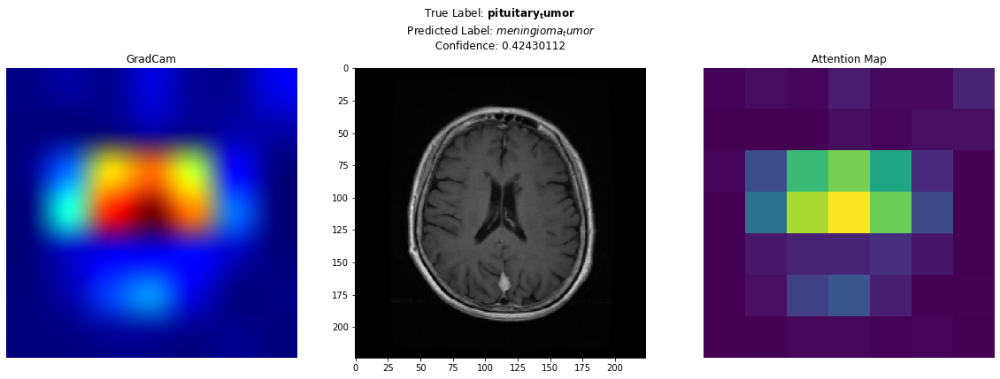

------------


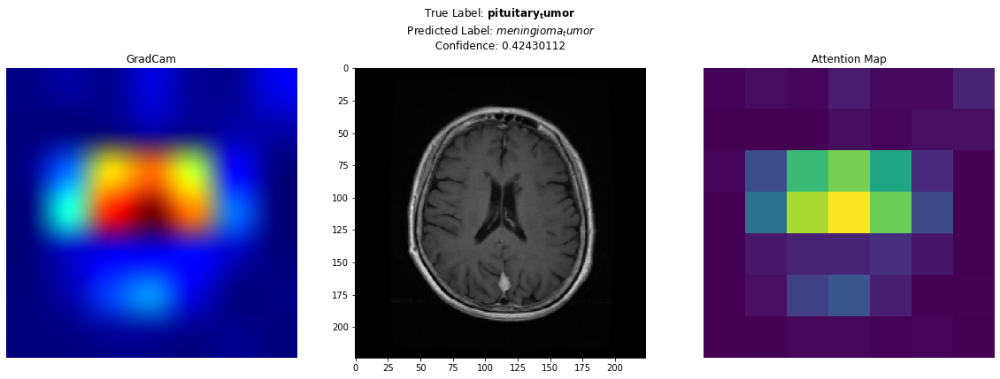

------------


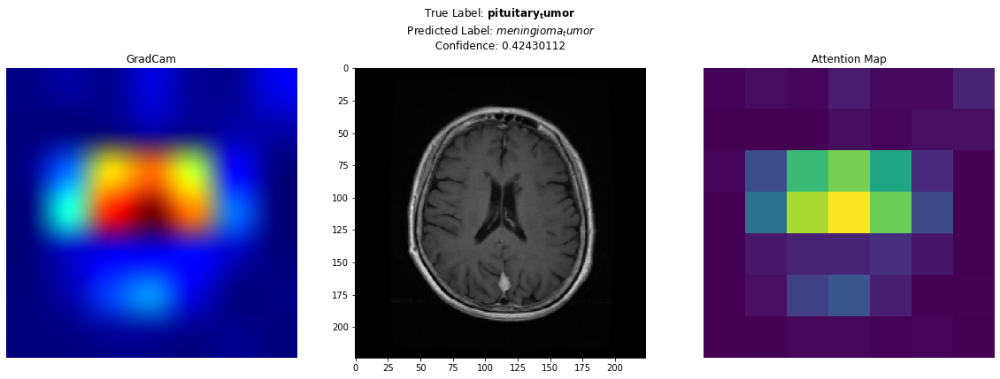

------------


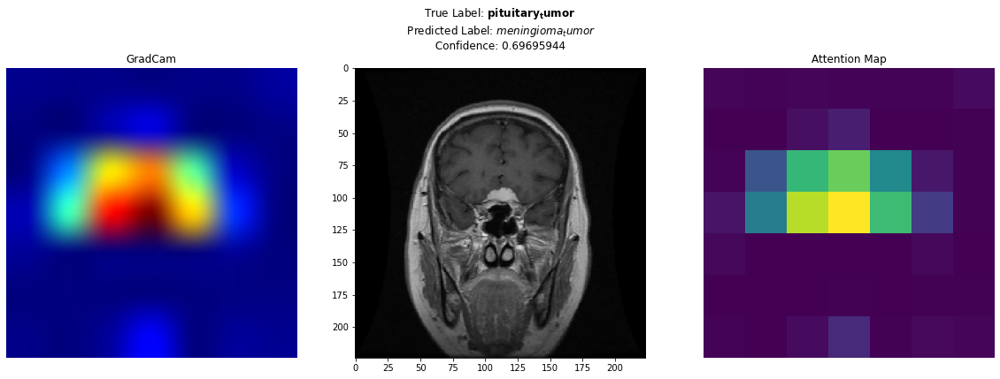

------------


In [46]:
sove_plots(false_predictions, model, last_layer_name)


---

<a id="s7"></a>
<center> <h2 style="color: #404040; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;">💭 VII - Conclusion 💭</h2></center>



- What metric is important for our case?

As the accuracy isn't a sufficient metric to mesure the performance of the model, looking at the F1 Score and Recall

- How to improve on these results?
    - Increase the size of the dataset
    - Train the model for more epochs for it to see more augmented data examples
    - Use Cross-Validation
    - Use Keras Tuner to tune the model Hyperparameters


---

<a id="s9"></a>
<center> <h2 style="color: #404040; font-family: 'Google Sans', serif; font-size: 45px; font-weight: normal; line-height: 48px; margin: 0;">📚️ XI - References 📚️</h2></center>



- GradCam: https://keras.io/examples/vision/grad_cam/
- Confusion Matrix: https://stackoverflow.com/questions/65952380/sort-multi-label-confusion-matrix
- Brain Tumor: https://www.abta.org/

---

<div>
    <center style="color: #404040; font-family:  sans-serif; font-size: 145px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; background: #f9f9f9;">Thank You</center>

<center style="color: #404040; font-family:  sans-serif; font-size: 100px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; background: #f9f9f9;">Taha Bouhsine</center>
    
<center style=" font-family: sans-serif; font-size: 31px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; background: #f9f9f9;"><span style="color:#4285F4;">G</span><span style="color:#EA4335">o</span><span style="color:#FBBC04;">o</span><span style="color:#4285F4;">g</span><span style="color:#34A853;">l</span><span style="color:#EA4335;">e</span> <span style="color:#404040;">Developer Student Clubs Lead</span><a href="https://gdsc.community.dev/university-of-ibn-zohr/"> @gdscuiz</a> </center>
    
<center style=" font-family: sans-serif; font-size: 31px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; background: #f9f9f9; color: #FF6F00;">TensorFlow User Group Agadir Lead Organizer<a href="https://www.meetup.com/TFUGAgadir/"> @tfugagadir</a> </center>

    
<center style=" font-size: 25px; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; color:#404040;">Find me <i class="fab fa-github"></i> <a href="https://github.com/skywolfmo">@skywolfmo</a> - <i class="fab fa-twitter"></i> <a href="https://twitter.com/Tahabsn">@tahabsn</a></center>
    
<center> <i class="fa-solid fa-image-portrait"></i> <a href="www.tahabouhsine.me">www.tahabouhsine.me</a></center>
</div>

<center><a href="https://www.youtube.com/watch?v=aj1Xj-WN8uo" ><img width='700px' src="https://i.imgur.com/9kLpNMf.png"/></a></center>
<center style=" font-family: 'Helvetica Neue', sans-serif; font-size: 20; font-weight: bold; letter-spacing: -1px; line-height: 1; text-align: center; color:#111;">26 April 2022</a></center>

<div class="alert alert-block alert-danger"> 🤗 Up-vote if you find it usefull</div>